<h1 id="tocheading">Table of Contents</h1>
<div id="toc"></div>

In [896]:
%%javascript
$.getScript('https://kmahelona.github.io/ipython_notebook_goodies/ipython_notebook_toc.js')


<IPython.core.display.Javascript object>

In [897]:
#import necessary libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)
import warnings
warnings.filterwarnings("ignore")
import imblearn
from imblearn.over_sampling import SMOTE

In [898]:
#Load the data
df = pd.read_csv("telecom_churn_data.csv")

In [899]:
df.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,214.816,213.803,21.100,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,0.00,0.00,0.00,0.00,NaN,NaN,0.16,NaN,NaN,NaN,4.13,NaN,NaN,NaN,1.15,NaN,NaN,NaN,5.44,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,0.00,0.00,5.44,0.00,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN,4,3,

In [900]:
#get the basic info abou the data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 226 entries, mobile_number to sep_vbc_3g
dtypes: float64(179), int64(35), object(12)
memory usage: 172.4+ MB


In [901]:
df.describe()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
count,9.999900e+04,99999.0,98981.0,98981.0,98981.0,99999.000000,99999.000000,99999.000000,99999.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.0,96140.0,94621.0,92254.0,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621

In [902]:
#Checking what are the object types
df.select_dtypes(include=object).head()

,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9
0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/21/2014,7/16/2014,8/8/2014,9/28/2014,6/21/2014,7/16/2014,8/8/2014,NaN
1,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/29/2014,7/31/2014,8/28/2014,9/30/2014,NaN,7/25/2014,8/10/2014,NaN
2,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/17/2014,7/24/2014,8/14/2014,9/29/2014,NaN,NaN,NaN,9/17/2014
3,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/28/2014,7/31/2014,8/31/2014,9/30/2014,NaN,NaN,NaN,NaN
4,6/30/2014,7/31/2014,8/31/2014,9/30/2014,6/26/2014,7/28/2014,8/9/2014,9/28/2014,6/4/2014,NaN,NaN,NaN


These columns will be addressed in EDA

## Handling Missing Values

In [903]:
#Checking for missing values 
df_null_rows = df.isnull()
row_has_NaN = df_null_rows.any(axis=1)
rows_with_NaN = df[row_has_NaN]
rows_with_NaN.sample(10)

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
68985,7001665146,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,182.834,0.000,0.000,0.000,0.00,NaN,0.00,0.00,0.18,NaN,0.80,0.00,0.00,NaN,0.0,0.0,0.00,NaN,0.0,0.0,0.00,NaN,0.00,0.00,0.00,NaN,0.00,0.00,0.00,NaN,0.0,0.00,0.18,NaN,0.80,0.00,0.00,NaN,0.00,0.00,0.00,NaN,0.00,0.00,0.00,NaN,0.00,0.00,0.00,NaN,0.00,0.00,0.0,NaN,0.0,0.0,0.00,NaN,0.00,0.00,0.0,NaN,0.0,0.0,0.18,NaN,0.80,0.61,0.00,NaN,0.0,0.0,0.18,0.00,0.80,0.61,37.03,NaN,0.40,4.98,97.64,NaN,0.53,14.09,6.36,NaN,0.00,0.00,141.04,NaN,0.93,19.08,0.93,NaN,0.00,0.00,3.38,NaN,0.36,2.36,4.56,NaN,0.00,0.00,0.0,NaN,0.0,0.0,8.88,NaN,0.36,2.36,152.59,0.00,1.29,21.44,0.00

Trying to split the datframe into related columns and haveing a look at each individually before imputing the null values

#### MOU Columns

In [904]:
#trying to divide the data frame with only columns that have mou

mou_df = df.filter(like="mou")
mou_df.head()

,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9
0,0.0,0.0,0.0,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,0.00,0.00,0.00,0.00,NaN,NaN,0.16,NaN,NaN,NaN,4.13,NaN,NaN,NaN,1.15,NaN,NaN,NaN,5.44,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,0.00,NaN,0.00,0.00,5.44,0.00,NaN,NaN,0.0,NaN,NaN,NaN,0.0,NaN
1,0.0,0.0,0.0,24.11,78.68,7.68,18.34,15.74,99.84,304.76,53.76,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,23.88,74.56,7.68,18.34,11.51,75.94,291.86,53.76,0.00,0.00,0.00,0.00,0.0,2.91,0.00,0.00,35.39,150.51,299.54,72.11,0.23,4.11,0.00,0.00,0.00,0.46,0.13,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.23,4.58,0.13,0.00,0.0,0.0,0.0,0.0,4.68,23.43,12.76,0.00,40.31,178.53,312.44,72.11,1.61,29.91,29.23,116.09,17.48,65.38,375.58,56.93,0.00,8.93,3.61,0.00,19.09,104.23,408.43,173.03,0.00,0.00,2.35,0.00,5.90,0.00,12.49,15.01,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,5.90,0.00,14.84,15.01,26.83,104.23,423.28,188.04,0.00,0.0,0.0,0.00,1.83,0.00,0.0,0.00
2,0.0,0.0,0.0,11.54,55.24,37.26,74.81,143.33,220.59,208.36,118.91,0.0,0.00,0.00,38.49,0.0,0.00,0.00,70.94,7.19,28.74,13.58,14.39,29.34,16.86,38.46,28.16,24.11,21.79,15.61,22.24,0.0,135.54,45.76,0.48,60.66,67.41,67.66,64.81,4.34,26.49,22.58,8.76,41.81,67.41,75.53,9.28,1.48,14.76,22.83,0.0,0.0,0.0,0.0,0.0,47.64,108.68,120.94,18.04,0.0,0.0,0.0,0.0,46.56,236.84,96.84,42.08,155.33,412.94,285.46,124.94,115.69,71.11,67.46,148.23,14.38,15.44,38.89,38.98,99.48,122.29,49.63,158.19,229.56,208.86,155.99,345.41,72.41,71.29,28.69,49.44,45.18,177.01,167.09,118.18,21.73,58.34,43.23,3.86,0.0,0.0,0.0,0.0,139.33,306.66,239.03,171.49,370.04,519.53,395.03,517.74,0.21,0.0,0.0,0.45,0.00,0.85,0.0,0.01
3,0.0,0.0,0.0,99.91,54.39,310.98,241.71,123.31,109.01,71.68,113.54,0.0,54.86,44.38,0.00,0.0,28.09,39.04,0.00,73.68,34.81,10.61,15.49,107.43,83.21,22.46,65.46,1.91,0.65,4.91,2.06,0.0,0.00,0.00,0.00,183.03,118.68,37.99,83.03,26.23,14.89,289.58,226.21,2.99,1.73,6.53,9.99,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,29.23,16.63,296.11,236.21,0.0,0.0,0.0,0.0,10.96,0.00,18

In [905]:
#Checking to see what the records of NA look like before deciding the method used for imputing them
df_null_rows = mou_df.isnull()
row_has_NaN = df_null_rows.any(axis=1)
rows_with_NaN = df[row_has_NaN]
rows_with_NaN.sample(10)

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
74907,7001676216,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,213.129,221.758,0.000,0.000,0.00,0.00,NaN,NaN,1.38,9.09,NaN,NaN,0.0,0.0,NaN,NaN,0.00,0.0,NaN,NaN,0.00,0.00,NaN,NaN,0.00,2.81,NaN,NaN,0.00,0.00,NaN,NaN,0.00,2.51,NaN,NaN,0.00,2.81,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,NaN,NaN,0.0,0.0,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.0,NaN,NaN,1.38,6.31,NaN,NaN,0.00,0.0,NaN,NaN,1.38,9.13,0.00,0.00,0.00,0.00,NaN,NaN,0.00,0.18,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.18,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.0,NaN,NaN,0.0,0.0,NaN,NaN,0.00,0.00,NaN,NaN,0.00,0.18,0.00,0.00,0.0,0.0,NaN,NaN,0.00,0.00,NaN,N

In [906]:
# The NA values can be imputed with 0
mou_col = mou_df.columns
df [mou_col] = df[mou_col].fillna(0)

In [907]:
#Checking for null values in every column
round(100*df.isnull().sum()/len(df),2)

mobile_number                0.00
circle_id                    0.00
loc_og_t2o_mou               0.00
std_og_t2o_mou               0.00
loc_ic_t2o_mou               0.00
last_date_of_month_6         0.00
last_date_of_month_7         0.60
last_date_of_month_8         1.10
last_date_of_month_9         1.66
arpu_6                       0.00
arpu_7                       0.00
arpu_8                       0.00
arpu_9                       0.00
onnet_mou_6                  0.00
onnet_mou_7                  0.00
onnet_mou_8                  0.00
onnet_mou_9                  0.00
offnet_mou_6                 0.00
offnet_mou_7                 0.00
offnet_mou_8                 0.00
offnet_mou_9                 0.00
roam_ic_mou_6                0.00
roam_ic_mou_7                0.00
roam_ic_mou_8                0.00
roam_ic_mou_9                0.00
roam_og_mou_6                0.00
roam_og_mou_7                0.00
roam_og_mou_8                0.00
roam_og_mou_9                0.00
loc_og_t2t_mou

Now the columns addressing the recharge activity are looked at

#### Recharge Columns

In [908]:
#trying to divide the data frame with only columns that have rech or rch
rch_col =[]
for col in df.columns:
    if "rech" in col or "rch" in col:
        rch_col.append(col)
rch_df = df[rch_col]
rch_df.head()


,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,date_of_last_rech_data_9,total_rech_data_6,total_rech_data_7,total_rech_data_8,total_rech_data_9,max_rech_data_6,max_rech_data_7,max_rech_data_8,max_rech_data_9,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_2g_9,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,count_rech_3g_9,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,av_rech_amt_data_9
0,4,3,2,6,362,252,252,0,252,252,252,0,6/21/2014,7/16/2014,8/8/2014,9/28/2014,252,252,252,0,6/21/2014,7/16/2014,8/8/2014,NaN,1.0,1.0,1.0,NaN,252.0,252.0,252.0,NaN,0.0,0.0,0.0,NaN,1.0,1.0,1.0,NaN,252.0,252.0,252.0,NaN
1,4,9,11,5,74,384,283,121,44,154,65,50,6/29/2014,7/31/2014,8/28/2014,9/30/2014,44,23,30,0,NaN,7/25/2014,8/10/2014,NaN,NaN,1.0,2.0,NaN,NaN,154.0,25.0,NaN,NaN,1.0,2.0,NaN,NaN,0.0,0.0,NaN,NaN,154.0,50.0,NaN
2,5,4,2,7,168,315,116,358,86,200,86,100,6/17/2014,7/24/2014,8/14/2014,9/29/2014,0,200,86,0,NaN,NaN,NaN,9/17/2014,NaN,NaN,NaN,1.0,NaN,NaN,NaN,46.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,46.0
3,10,11,18,14,230,310,601,410,60,50,50,50,6/28/2014,7/31/2014,8/31/2014,9/30/2014,30,50,50,30,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,6,3,4,196,350,287,200,56,110,110,50,6/26/2014,7/28/2014,8/9/2014,9/28/2014,50,110,110,50,6/4/2014,NaN,NaN,NaN,1.0,NaN,NaN,NaN,56.0,NaN,NaN,NaN,1.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,56.0,NaN,NaN,NaN


In [909]:
#Checking for null values in every column with regard to recharge
round(100*rch_df.isnull().sum()/len(rch_df),2)

total_rech_num_6             0.00
total_rech_num_7             0.00
total_rech_num_8             0.00
total_rech_num_9             0.00
total_rech_amt_6             0.00
total_rech_amt_7             0.00
total_rech_amt_8             0.00
total_rech_amt_9             0.00
max_rech_amt_6               0.00
max_rech_amt_7               0.00
max_rech_amt_8               0.00
max_rech_amt_9               0.00
date_of_last_rech_6          1.61
date_of_last_rech_7          1.77
date_of_last_rech_8          3.62
date_of_last_rech_9          4.76
last_day_rch_amt_6           0.00
last_day_rch_amt_7           0.00
last_day_rch_amt_8           0.00
last_day_rch_amt_9           0.00
date_of_last_rech_data_6    74.85
date_of_last_rech_data_7    74.43
date_of_last_rech_data_8    73.66
date_of_last_rech_data_9    74.08
total_rech_data_6           74.85
total_rech_data_7           74.43
total_rech_data_8           73.66
total_rech_data_9           74.08
max_rech_data_6             74.85
max_rech_data_

Null values that are more than 50% for hence can drop these columns date_of_last_rech_data*, total_rech_data *, max_rech_data_*, count_rech_2g*, count_rech_3g_*, av_rech_amt_data_*

In [910]:
df_null = round(100*rch_df.isnull().sum()/len(df),2)
null_cols = df_null[df_null>50]
null_cols

date_of_last_rech_data_6    74.85
date_of_last_rech_data_7    74.43
date_of_last_rech_data_8    73.66
date_of_last_rech_data_9    74.08
total_rech_data_6           74.85
total_rech_data_7           74.43
total_rech_data_8           73.66
total_rech_data_9           74.08
max_rech_data_6             74.85
max_rech_data_7             74.43
max_rech_data_8             73.66
max_rech_data_9             74.08
count_rech_2g_6             74.85
count_rech_2g_7             74.43
count_rech_2g_8             73.66
count_rech_2g_9             74.08
count_rech_3g_6             74.85
count_rech_3g_7             74.43
count_rech_3g_8             73.66
count_rech_3g_9             74.08
av_rech_amt_data_6          74.85
av_rech_amt_data_7          74.43
av_rech_amt_data_8          73.66
av_rech_amt_data_9          74.08
dtype: float64

In [911]:
#Dropping the columns with more than 50% null values
df.drop(null_cols.index,axis=1,inplace =True)
rch_df.drop(null_cols.index,axis=1,inplace =True)

In [912]:
#Checking for null values in every column with regard to recharge
round(100*rch_df.isnull().sum()/len(rch_df),2)

total_rech_num_6       0.00
total_rech_num_7       0.00
total_rech_num_8       0.00
total_rech_num_9       0.00
total_rech_amt_6       0.00
total_rech_amt_7       0.00
total_rech_amt_8       0.00
total_rech_amt_9       0.00
max_rech_amt_6         0.00
max_rech_amt_7         0.00
max_rech_amt_8         0.00
max_rech_amt_9         0.00
date_of_last_rech_6    1.61
date_of_last_rech_7    1.77
date_of_last_rech_8    3.62
date_of_last_rech_9    4.76
last_day_rch_amt_6     0.00
last_day_rch_amt_7     0.00
last_day_rch_amt_8     0.00
last_day_rch_amt_9     0.00
dtype: float64

In [913]:
#Checking to see what the records of NA look like before deciding the method used for imputing them
df_null_rows = rch_df.isnull()
row_has_NaN = df_null_rows.any(axis=1)
rows_with_NaN = rch_df[row_has_NaN]
rows_with_NaN.sample(10)

,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9
59672,9,2,0,0,829,300,0,0,250,150,0,0,6/30/2014,7/11/2014,NaN,NaN,179,150,0,0
35514,3,1,1,0,0,0,0,0,0,0,0,0,6/20/2014,7/20/2014,8/12/2014,NaN,0,0,0,0
98823,0,25,29,30,0,467,656,681,0,67,130,50,NaN,7/31/2014,8/31/2014,9/29/2014,0,30,30,30
17427,3,2,0,9,228,110,0,523,128,110,0,130,6/23/2014,7/25/2014,NaN,9/30/2014,128,0,0,114
70692,3,3,0,0,0,0,0,0,0,0,0,0,6/27/2014,7/17/2014,NaN,NaN,0,0,0,0
59467,1,0,1,2,30,0,30,80,30,0,30,50,6/23/2014,NaN,8/15/2014,9/17/2014,30,0,30,50
42400,7,5,0,1,250,170,0,0,50,120,0,0,6/27/2014,7/30/2014,NaN,9/20/2014,30,0,0,0
51050,9,13,2,0,276,620,30,0,50,250,30,0,6/26/2014,7/23/2014,8/28/2014,NaN,10,0,0,0
60215,2,2,1,0,240,240,50,0,120,120,50,0,6/17/2014,7/25/2014,8/21/2014,NaN,120,120,50,0
98329,13,2,1,0,541,0,0,0,50,0,0,0,6/29/2014,7/17/2014,8/1/2014,NaN,50,0,0,0


In [914]:
#Imputing the missing date cols with mode of respective date column
missing_cols = ['date_of_last_rech_6','date_of_last_rech_7','date_of_last_rech_8','date_of_last_rech_9']

for col in missing_cols:
    rch_df[col].fillna((rch_df[col].mode()[0]), inplace=True) #subset table for easier viewing
    df[col].fillna((df[col].mode()[0]), inplace=True) #actual dataframe 

In [915]:
#rechecking if imputed properly
rch_df.sample(10)

,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9
56049,12,12,17,8,246,506,596,203,70,110,150,36,6/29/2014,7/31/2014,8/31/2014,9/28/2014,70,20,50,30
3498,19,13,13,22,1692,1308,1418,1216,110,110,144,130,6/30/2014,7/31/2014,8/30/2014,9/30/2014,110,110,130,50
28900,8,10,10,10,446,891,899,705,110,128,144,144,6/29/2014,7/29/2014,8/26/2014,9/29/2014,110,128,144,0
63114,8,5,6,7,1025,790,1185,1122,325,250,250,325,6/29/2014,7/20/2014,8/30/2014,9/29/2014,325,250,145,0
89032,4,4,5,5,60,60,90,60,30,30,30,30,6/13/2014,7/31/2014,8/26/2014,9/28/2014,30,30,30,0
64021,6,13,4,3,96,150,20,56,36,20,10,36,6/28/2014,7/28/2014,8/31/2014,9/30/2014,36,10,10,36
10555,70,1,6,6,1590,10,90,80,110,10,50,30,6/30/2014,7/1/2014,8/25/2014,9/29/2014,20,10,0,0
17148,6,9,2,6,460,838,130,350,110,200,130,200,6/29/2014,7/29/2014,8/26/2014,9/29/2014,110,110,130,0
66541,6,7,8,7,577,579,638,443,110,128,169,149,6/30/2014,7/26/2014,8/31/2014,9/24/2014,110,128,0,130
96751,9,11,20,10,286,416,471,261,50,110,130,130,6/30/2014,7/20/2014,8/28/2014,9/29/2014,0,110,30,0


In [916]:
#Checking for null values in every column with regard to recharge
round(100*rch_df.isnull().sum()/len(rch_df),2)

total_rech_num_6       0.0
total_rech_num_7       0.0
total_rech_num_8       0.0
total_rech_num_9       0.0
total_rech_amt_6       0.0
total_rech_amt_7       0.0
total_rech_amt_8       0.0
total_rech_amt_9       0.0
max_rech_amt_6         0.0
max_rech_amt_7         0.0
max_rech_amt_8         0.0
max_rech_amt_9         0.0
date_of_last_rech_6    0.0
date_of_last_rech_7    0.0
date_of_last_rech_8    0.0
date_of_last_rech_9    0.0
last_day_rch_amt_6     0.0
last_day_rch_amt_7     0.0
last_day_rch_amt_8     0.0
last_day_rch_amt_9     0.0
dtype: float64

In [917]:
#Checking for columns that are yet to be handled with null values 
null_cols = df.columns[round(100*df.isnull().sum()/len(df),2) >0]
round(100*df[null_cols].isnull().sum()/len(df),2)


last_date_of_month_7     0.60
last_date_of_month_8     1.10
last_date_of_month_9     1.66
og_others_6              3.94
og_others_7              3.86
og_others_8              5.38
og_others_9              7.75
ic_others_6              3.94
ic_others_7              3.86
ic_others_8              5.38
ic_others_9              7.75
arpu_3g_6               74.85
arpu_3g_7               74.43
arpu_3g_8               73.66
arpu_3g_9               74.08
arpu_2g_6               74.85
arpu_2g_7               74.43
arpu_2g_8               73.66
arpu_2g_9               74.08
night_pck_user_6        74.85
night_pck_user_7        74.43
night_pck_user_8        73.66
night_pck_user_9        74.08
fb_user_6               74.85
fb_user_7               74.43
fb_user_8               73.66
fb_user_9               74.08
dtype: float64

#### ARPU Columns

In [918]:
#Checking columns with word arpu
df.filter(like ="arpu").sample(10)

,arpu_6,arpu_7,arpu_8,arpu_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9
10587,622.170,712.536,754.864,1006.078,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25930,298.772,91.404,135.200,114.800,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
14740,86.711,232.622,257.918,235.676,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22934,103.476,85.861,75.146,91.746,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10321,161.926,7.348,44.028,110.674,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
60890,202.210,218.925,193.332,255.708,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34840,90.767,55.294,25.987,-5.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24762,120.295,100.999,-0.170,-1.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
74628,113.497,102.094,70.886,88.786,NaN,0.0,NaN,NaN,NaN,0.0,NaN,NaN
2915,78.200,24.978,61.340,14.430,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [919]:
#Checking to see what the records of NA look like before deciding the method used for imputing them
df_arpu = df.filter(like ="arpu")
df_null_rows = df_arpu.isnull()
row_has_NaN = df_null_rows.any(axis=1)
rows_with_NaN = df[row_has_NaN]
rows_with_NaN.sample(10)

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
76161,7001499992,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,356.216,325.568,16.000,106.441,175.99,218.51,1.15,20.04,214.49,241.53,14.18,60.08,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,35.28,32.73,1.15,6.03,158.48,143.06,6.76,46.23,0.00,1.64,0.00,0.15,0.00,4.25,0.00,0.00,193.76,177.44,7.91,52.41,140.48,185.78,0.00,14.01,56.01,91.11,7.41,13.69,0.23,0.0,0.00,0.0,0.0,0.0,0.0,0.0,196.73,276.89,7.41,27.71,0.0,0.0,0.0,0.0,0.00,5.69,0.00,0.00,0.00,0.0,0.0,0.0,390.49,460.04,15.33,80.13,65.81,736.98,25.76,13.69,195.86,140.88,90.09,68.89,4.34,9.23,8.91,3.78,266.03,887.09,124.78,86.38,0.40,38.11,2.61,4.21,38.81,628.79,25.83,30.04,1.06,0.00,0.00,0.00,0.0,0.0,0.0,0.0,40.28,666.91,28.44,34.26,306.64,1554.01,153.48,120.78,0.26,0.00,0.25,0.13,0.00,0.00,0.00,0.0,0.06,0.00,0.00,0.0,7,9,3,7,390,356,50,115,110,110,50,30,6/30/2014,7/30/2014,8/27/2014,9/30/2014,30,0,50,0,0.00,0.00,0.00,1.47,0.00,0.00,0.00,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,1.4,NaN,NaN,NaN,0.0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1.0,3499,0.0,0.00,0.00,0.0
57039,7000241387,109,0.0,0.0,0.0,6/30/20

In [920]:
#We can either drop these rows or impute with 0
arpu_cols = df.filter(like ="arpu").columns
df[arpu_cols] = df[arpu_cols].fillna(0)

In [921]:
#Checking for columns that are yet to be handled with null values 
null_cols = df.columns[round(100*df.isnull().sum()/len(df),2) >0]
round(100*df[null_cols].isnull().sum()/len(df),2)

last_date_of_month_7     0.60
last_date_of_month_8     1.10
last_date_of_month_9     1.66
og_others_6              3.94
og_others_7              3.86
og_others_8              5.38
og_others_9              7.75
ic_others_6              3.94
ic_others_7              3.86
ic_others_8              5.38
ic_others_9              7.75
night_pck_user_6        74.85
night_pck_user_7        74.43
night_pck_user_8        73.66
night_pck_user_9        74.08
fb_user_6               74.85
fb_user_7               74.43
fb_user_8               73.66
fb_user_9               74.08
dtype: float64

#### User columns

In [922]:
#Checking columns with word user
df.filter(like ="user").sample(10)

,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9
2071,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4896,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
24357,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0
29335,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0
92970,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
70655,0.0,NaN,0.0,0.0,1.0,NaN,1.0,1.0
87184,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25501,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
45432,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
30442,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [923]:
#Checking columns with word user
df.filter(like ="user").describe()

,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9
count,25153.000000,25571.000000,26339.000000,25922.000000,25153.000000,25571.000000,26339.000000,25922.000000
mean,0.025086,0.023034,0.020844,0.015971,0.914404,0.908764,0.890808,0.860968
std,0.156391,0.150014,0.142863,0.125366,0.279772,0.287950,0.311885,0.345987
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
50%,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [924]:
#We can either drop these rows or impute with 0 meaning they dont have the pack
user_cols = df.filter(like ="user").columns
df[user_cols] = df[user_cols].fillna(0)

In [925]:
#Checking for columns that are yet to be handled with null values 
null_cols = df.columns[round(100*df.isnull().sum()/len(df),2) >0]
round(100*df[null_cols].isnull().sum()/len(df),2)

last_date_of_month_7    0.60
last_date_of_month_8    1.10
last_date_of_month_9    1.66
og_others_6             3.94
og_others_7             3.86
og_others_8             5.38
og_others_9             7.75
ic_others_6             3.94
ic_others_7             3.86
ic_others_8             5.38
ic_others_9             7.75
dtype: float64

####  Others Columns

In [926]:
#Checking columns with word user
df.filter(like ="others").sample(10)

,og_others_6,og_others_7,og_others_8,og_others_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9
95423,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.00
43768,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.00
96886,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.00
34206,0.00,0.0,0.0,0.0,0.00,2.03,0.15,0.13
78417,0.00,0.0,0.0,0.0,0.00,5.41,1.93,0.00
3591,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.00
25442,0.00,0.0,0.0,0.0,0.20,0.31,0.28,1.99
4329,2.55,0.0,0.0,0.0,2.11,0.00,0.00,3.31
86474,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.00
79356,0.00,0.0,0.0,0.0,0.00,0.00,0.00,0.00


In [927]:
#We impute with 0 
user_cols = df.filter(like ="other").columns
df[user_cols] = df[user_cols].fillna(0)

#### Last_Date Column

In [928]:
#Checking columns with word user
df.filter(like ="last_date").sample(10)

,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9
17788,6/30/2014,7/31/2014,8/31/2014,9/30/2014
3717,6/30/2014,7/31/2014,8/31/2014,9/30/2014
12868,6/30/2014,7/31/2014,8/31/2014,9/30/2014
80427,6/30/2014,7/31/2014,8/31/2014,9/30/2014
61896,6/30/2014,7/31/2014,8/31/2014,9/30/2014
99208,6/30/2014,7/31/2014,8/31/2014,9/30/2014
16064,6/30/2014,7/31/2014,8/31/2014,9/30/2014
22124,6/30/2014,7/31/2014,8/31/2014,9/30/2014
25890,6/30/2014,7/31/2014,8/31/2014,9/30/2014
88327,6/30/2014,7/31/2014,8/31/2014,9/30/2014


In [929]:
#Checking to see what the records of NA look like before deciding the method used for imputing them
df_last_date = df.filter(like ="last_date")
df_null_rows = df_last_date.isnull()
row_has_NaN = df_null_rows.any(axis=1)
rows_with_NaN = df[row_has_NaN]
rows_with_NaN

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
67,7000800341,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,NaN,218.818,386.515,386.502,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.30,0.00,1.11,0.0,6.11,61.86,44.48,0.0,0.00,0.00,0.00,0.0,6.41,61.86,45.59,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,6.41,61.86,131.43,0.0,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0,0.00,0.00,85.83,0.0,3,4,3,0,252,455,455,0,252,455,455,0,6/25/2014,7/16/2014,8/2/2014,9/29/2014,252,455,0,0,42.89,19.07,0.00,0.0,2042.38,3189.85,0.00,0.0,224.00,389.01,0.00,0.0,224.00,389.00,0.00,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,1.0,1.0,0.0,0.0,1158,126.21,745.73,1010.15,0.00
144,7000816313,109,0.0,0.0,0.0,6/30/2014,NaN,NaN,NaN,340.765,0.000,0.000,0.0,45.28,0.00,0.00,0.0,114.79,0.00,0.0

In [930]:
df_last_date = df.filter(like ="last_date")
df_null_rows = df_last_date.isnull()
row_has_NaN = df_null_rows.any(axis=1)
rows_with_NaN = df[row_has_NaN]
rows_with_NaN[["last_date_of_month_6", "last_date_of_month_7", "last_date_of_month_8", "last_date_of_month_9", "arpu_6", "arpu_7", "arpu_8", "arpu_9"]]

,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9
67,6/30/2014,7/31/2014,8/31/2014,NaN,218.818,386.515,386.502,0.0
144,6/30/2014,NaN,NaN,NaN,340.765,0.000,0.000,0.0
161,6/30/2014,7/31/2014,NaN,NaN,52.288,37.849,0.000,0.0
188,6/30/2014,7/31/2014,NaN,NaN,734.641,183.668,0.000,0.0
197,6/30/2014,7/31/2014,8/31/2014,NaN,106.900,141.250,58.310,0.0
202,6/30/2014,NaN,NaN,NaN,126.339,0.000,0.000,0.0
216,6/30/2014,NaN,NaN,NaN,44.550,0.000,0.000,0.0
232,6/30/2014,NaN,8/31/2014,NaN,0.700,0.000,108.460,0.0
275,6/30/2014,NaN,NaN,NaN,90.208,0.000,0.000,0.0
279,6/30/2014,NaN,8/31/2014,NaN,0.900,0.000,106.760,0.0


The above records show NaN values for last_date_of_month if the customer has not having any record of arpu or in other words has not generated any revenue. This could be used to flag the user as a "Churn" case

#### Filter High Value Costumer (HVC)

In [931]:
# calculate average recharge done by customer in 6th and 7th month
df['avg_recharge_amount_6_7'] = (df.total_rech_amt_6   + df.total_rech_amt_7 )/2


In [932]:
#Find the 70th percentile value for avg_recharge_amount_6_7 column
recharge_70th_per=df.avg_recharge_amount_6_7.quantile(0.7)

In [933]:
print("Recharge amount at 70th percentile is",recharge_70th_per)

Recharge amount at 70th percentile is 368.5


In [934]:
# Retain those customers whose average amount in 6th and 7th month is greater than or equal to 70th percentile
df_filtered = df.loc[df.avg_recharge_amount_6_7 >= recharge_70th_per, :]

df_filtered.shape

(30011, 203)

In [935]:
df_filtered.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,avg_recharge_amount_6_7
7,7000701601,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,1069.180,1349.850,3171.480,500.000,57.84,54.68,52.29,0.00,453.43,567.16,325.91,0.00,16.23,33.49,31.64,0.00,23.74,12.59,38.06,0.00,51.39,31.38,40.28,0.00,308.63,447.38,162.28,0.00,62.13,55.14,53.23,0.00,0.0,0.0,0.00,0.0,422.16,533.91,255.79,0.00,4.30,23.29,12.01,0.00,49.89,31.76,49.14,0.00,6.66,20.08,16.68,0.00,0.0,0.0,0.0,0.0,60.86,75.14,77.84,0.00,0.0,0.18,10.01,0.0,4.50,0.00,6.50,0.00,0.00,0.0,0.0,0.0,487.53,609.24,350.16,0.00,58.14,32.26,27.31,0.00,217.56,221.49,121.19,0.00,152.16,101.46,39.53,0.00,427.88,355.23,188.04,0.00,36.89,11.83,30.39,0.00,91.44,126.99,141.33,0.00,52.19,34.24,22.21,0.0,0.0,0.0,0.0,0.0,180.54,173.08,193.94,0.00,626.46,558.04,428.74,0.00,0.21,0.0,0.0,0.0,2.06,14.53,31.59,0.00,15.74,15.19,15.14,0.00,5,5,7,3,1580,790,3638,0,1580,790,1580,0,6/27/2014,7/25/2014,8/26/2014,9/30/2014,0,0,779,0,0.0,0.0,0.00,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,802,57.74,19.38,18.74,

In [936]:
#Rechecking the basic info 
df_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30011 entries, 7 to 99997
Columns: 203 entries, mobile_number to avg_recharge_amount_6_7
dtypes: float64(160), int64(35), object(8)
memory usage: 46.7+ MB


### Derive Churn

In [937]:
# Caluculate the total Incoming minutes of usage

#Doubt whether to sum up all the incoming mou of all the months

Those who have not made any calls (either incoming or outgoing) AND have not used mobile internet even once in the churn phase. The attributes you need to use to tag churners are:

total_ic_mou_9

total_og_mou_9

vol_2g_mb_9

vol_3g_mb_9

In [938]:
df_filtered["Churn"] = (df_filtered.total_ic_mou_9 ==0) & (df_filtered.total_og_mou_9 ==0) & (df_filtered.vol_2g_mb_9 ==0) & (df_filtered.vol_3g_mb_9 ==0)
df_filtered.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,roam_og_mou_9,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2t_mou_9,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2m_mou_9,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2f_mou_9,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_t2c_mou_9,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,loc_og_mou_9,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2t_mou_9,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2m_mou_9,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2f_mou_9,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_t2c_mou_9,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_9,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,isd_og_mou_9,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,spl_og_mou_9,og_others_6,og_others_7,og_others_8,og_others_9,total_og_mou_6,total_og_mou_7,total_og_mou_8,total_og_mou_9,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2t_mou_9,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2m_mou_9,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_t2f_mou_9,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,loc_ic_mou_9,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2t_mou_9,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2m_mou_9,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2f_mou_9,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_t2o_mou_9,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,std_ic_mou_9,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,total_ic_mou_9,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,spl_ic_mou_9,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,isd_ic_mou_9,ic_others_6,ic_others_7,ic_others_8,ic_others_9,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_num_9,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,total_rech_amt_9,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,max_rech_amt_9,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,date_of_last_rech_9,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,last_day_rch_amt_9,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_2g_mb_9,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_3g_9,arpu_2g_6,arpu_2g_7,arpu_2g_8,arpu_2g_9,night_pck_user_6,night_pck_user_7,night_pck_user_8,night_pck_user_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g,avg_recharge_amount_6_7,Churn
7,7000701601,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,1069.180,1349.850,3171.480,500.000,57.84,54.68,52.29,0.00,453.43,567.16,325.91,0.00,16.23,33.49,31.64,0.00,23.74,12.59,38.06,0.00,51.39,31.38,40.28,0.00,308.63,447.38,162.28,0.00,62.13,55.14,53.23,0.00,0.0,0.0,0.00,0.0,422.16,533.91,255.79,0.00,4.30,23.29,12.01,0.00,49.89,31.76,49.14,0.00,6.66,20.08,16.68,0.00,0.0,0.0,0.0,0.0,60.86,75.14,77.84,0.00,0.0,0.18,10.01,0.0,4.50,0.00,6.50,0.00,0.00,0.0,0.0,0.0,487.53,609.24,350.16,0.00,58.14,32.26,27.31,0.00,217.56,221.49,121.19,0.00,152.16,101.46,39.53,0.00,427.88,355.23,188.04,0.00,36.89,11.83,30.39,0.00,91.44,126.99,141.33,0.00,52.19,34.24,22.21,0.0,0.0,0.0,0.0,0.0,180.54,173.08,193.94,0.00,626.46,558.04,428.74,0.00,0.21,0.0,0.0,0.0,2.06,14.53,31.59,0.00,15.74,15.19,15.14,0.00,5,5,7,3,1580,790,3638,0,1580,790,1580,0,6/27/2014,7/25/2014,8/26/2014,9/30/2014,0,0,779,0,0.0,0.0,0.00,0.0,0.0,0.00,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,802,57.74,19.38,

In [939]:
df_filtered["Churn"].value_counts(normalize=True)

False    0.913598
True     0.086402
Name: Churn, dtype: float64

There is a class imbalance which has to be addressed before modelling 

In [940]:
#Trying to drop rows with 9 
columns_9 = df_filtered.filter(like ="9").columns
columns_9

Index(['last_date_of_month_9', 'arpu_9', 'onnet_mou_9', 'offnet_mou_9',
       'roam_ic_mou_9', 'roam_og_mou_9', 'loc_og_t2t_mou_9',
       'loc_og_t2m_mou_9', 'loc_og_t2f_mou_9', 'loc_og_t2c_mou_9',
       'loc_og_mou_9', 'std_og_t2t_mou_9', 'std_og_t2m_mou_9',
       'std_og_t2f_mou_9', 'std_og_t2c_mou_9', 'std_og_mou_9', 'isd_og_mou_9',
       'spl_og_mou_9', 'og_others_9', 'total_og_mou_9', 'loc_ic_t2t_mou_9',
       'loc_ic_t2m_mou_9', 'loc_ic_t2f_mou_9', 'loc_ic_mou_9',
       'std_ic_t2t_mou_9', 'std_ic_t2m_mou_9', 'std_ic_t2f_mou_9',
       'std_ic_t2o_mou_9', 'std_ic_mou_9', 'total_ic_mou_9', 'spl_ic_mou_9',
       'isd_ic_mou_9', 'ic_others_9', 'total_rech_num_9', 'total_rech_amt_9',
       'max_rech_amt_9', 'date_of_last_rech_9', 'last_day_rch_amt_9',
       'vol_2g_mb_9', 'vol_3g_mb_9', 'arpu_3g_9', 'arpu_2g_9',
       'night_pck_user_9', 'monthly_2g_9', 'sachet_2g_9', 'monthly_3g_9',
       'sachet_3g_9', 'fb_user_9'],
      dtype='object')

In [941]:
df_filtered = df_filtered.drop(columns_9,axis=1)
df_filtered = df_filtered.drop("sep_vbc_3g",axis=1)

In [942]:
df_filtered.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,avg_recharge_amount_6_7,Churn
7,7000701601,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,1069.180,1349.850,3171.480,57.84,54.68,52.29,453.43,567.16,325.91,16.23,33.49,31.64,23.74,12.59,38.06,51.39,31.38,40.28,308.63,447.38,162.28,62.13,55.14,53.23,0.0,0.0,0.00,422.16,533.91,255.79,4.30,23.29,12.01,49.89,31.76,49.14,6.66,20.08,16.68,0.0,0.0,0.0,60.86,75.14,77.84,0.0,0.18,10.01,4.50,0.00,6.50,0.00,0.0,0.0,487.53,609.24,350.16,58.14,32.26,27.31,217.56,221.49,121.19,152.16,101.46,39.53,427.88,355.23,188.04,36.89,11.83,30.39,91.44,126.99,141.33,52.19,34.24,22.21,0.0,0.0,0.0,180.54,173.08,193.94,626.46,558.04,428.74,0.21,0.0,0.0,2.06,14.53,31.59,15.74,15.19,15.14,5,5,7,1580,790,3638,1580,790,1580,6/27/2014,7/25/2014,8/26/2014,0,0,779,0.0,0.0,0.00,0.0,0.00,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,802,57.74,19.38,18.74,1185.0,True
8,7001524846,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,378.721,492.223,137.362,413.69,351.03,35.08,94.66,80.63,136.48,0.00,0.00,0.00,0.00,0.00,0.00,297.13,217.59,12.49,80.96,70.58,50.54,0.00,0.00,0.00,0.0,0.0,7.15,378.09,288.18,63.04,116.56,133.43,22.58,13.69,10.04,75.69,0.00,0.00,0.00,0.0,0.0,0.0,130.26,143.48,98.28,0.0,0.00,0.00,0.00,0.00,10.23,0.00,0.0,0.0,508.36,431.66,171.56,23.84,9.84,0.31,57.58,13.98,15.48,0.00,0.00,0.00,81.43,23.83,15.79,0.00,0.58,0.10,22.43,4.08,0.65,0.00,0.00,0.00,0.0,0.0,0.0,22.43,4.66,0.75,103.86,28.49,16.54,0.00,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.00,19,21,14,437,601,120,90,154,30,6/25/2014,7/31/2014,8/30/2014,50,0,10,0.0,356.0,0.03,0.0,750.95,11.94,0.0,0.0,19.83,0.0,0.0,0.0,0.0,0.0,0.0,0,1,0,0,1,3,0,0,0,0,0,0,0.0,1.0,1.0,315,21.03,910.65,122.16,519.0,False
13,7002191713,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,492.846,205.671,593.260,501.76,108.39,534.24,413.31

### Drop Columns with no info

In [943]:
col_to_drop =['circle_id', 'mobile_number', 'last_date_of_month_6','last_date_of_month_7','last_date_of_month_8','date_of_last_rech_6','date_of_last_rech_7','date_of_last_rech_8']
df_filtered.drop(col_to_drop,inplace=True,axis=1)

### EDA

### Univariate Analysis

Text(0.5, 1.0, 'Distribution of churn customers')

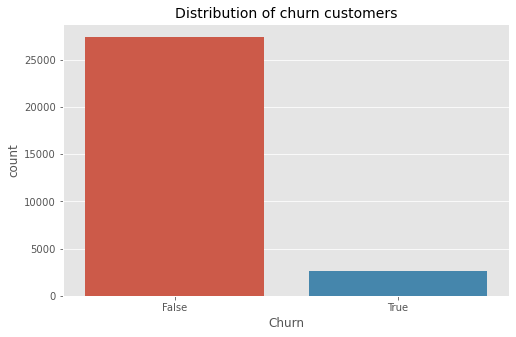

In [944]:
#Distribution of churn customers
plt.figure(figsize=(8,5))
# df_filtered['Churn'].value_counts().plot(kind = 'bar')
sns.countplot(df_filtered['Churn'])
# plt.ylabel('Count')
# plt.xlabel('Churn')
plt.title('Distribution of churn customers',fontsize=14)



#### ONNET and OFFNET

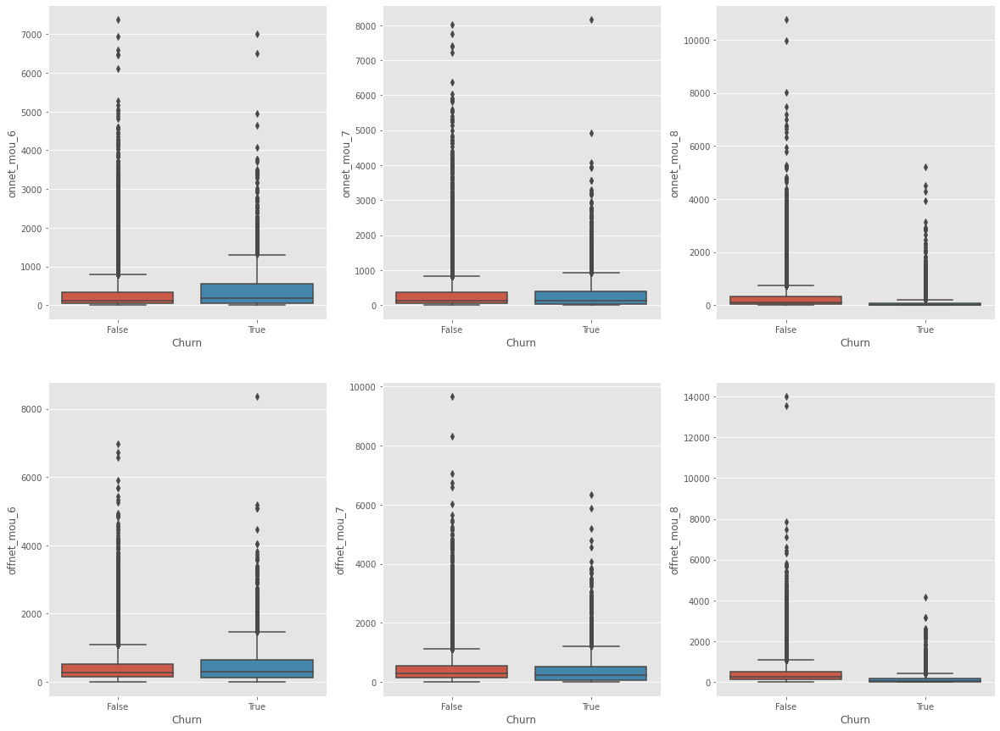

In [945]:
#Checking boxplots of offnet and onnet mou
plt.figure(figsize = (20,15))
on_off_mou_columns = ["onnet_mou_6","onnet_mou_7","onnet_mou_8","offnet_mou_6","offnet_mou_7","offnet_mou_8"]
for i, col in enumerate(on_off_mou_columns):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

In [946]:
#helper function to treat the outliers the values thare greater than 90 percentile are capped at 90 percentile
def func_outlier_treatment(col_list,df):
    for i, col in enumerate(col_list):
        upper_limit = df[col].quantile(.9)
        df[col][df[col]>upper_limit] = upper_limit
    return df

### Handling Outliers for ONNET and OFNET

In [947]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(on_off_mou_columns,df_filtered)

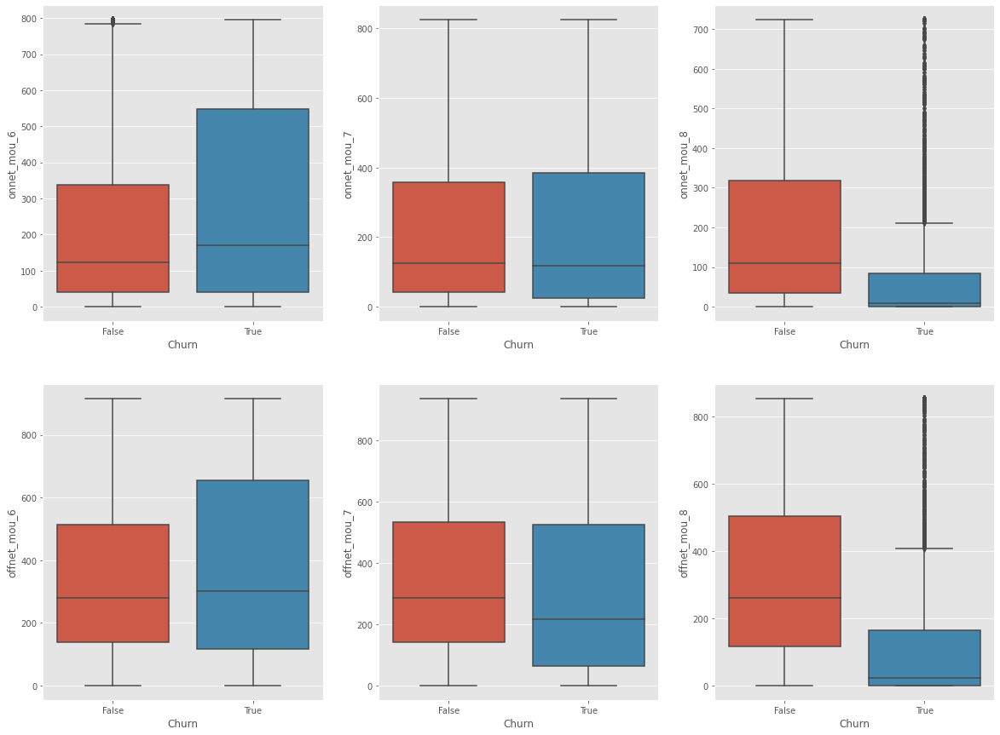

In [948]:
#Checking boxplots of offnet and onnet mou
plt.figure(figsize = (20,15))
on_off_mou_columns = ["onnet_mou_6","onnet_mou_7","onnet_mou_8","offnet_mou_6","offnet_mou_7","offnet_mou_8"]
for i, col in enumerate(on_off_mou_columns):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There is a drop in minutes of usauge for churners in the month of July. In August there is a drastic drop.

#### Average Revenue Per User(arpu)

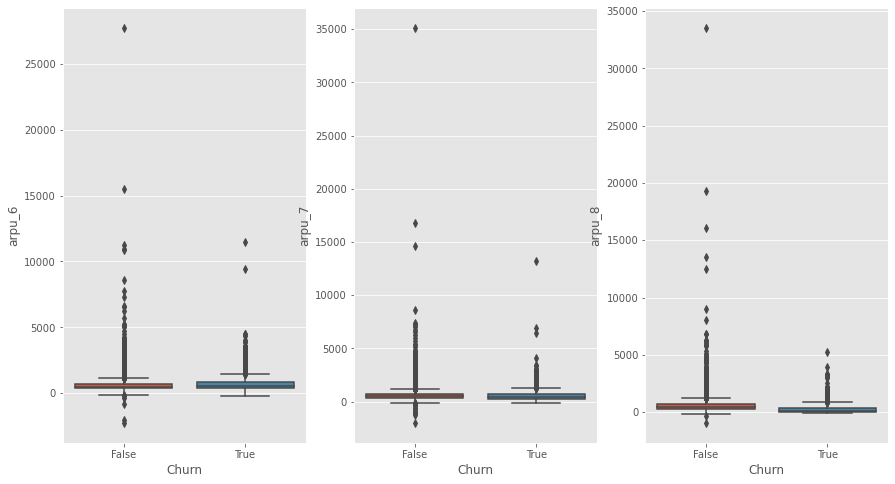

In [949]:
#Checking boxplots of arpu
plt.figure(figsize = (20,8))
arpu_columns = ["arpu_6", "arpu_7", "arpu_8"]
for i, col in enumerate(arpu_columns):
    plt.subplot(1,4,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Average Revenue Per User(arpu)

In [950]:
df_filtered[arpu_columns].describe()

,arpu_6,arpu_7,arpu_8
count,30011.000000,30011.000000,30011.000000
mean,587.284404,589.135427,534.857433
std,442.722413,462.897814,492.259586
min,-2258.709000,-2014.045000,-945.808000
25%,364.161000,365.004500,289.609500
50%,495.682000,493.561000,452.091000
75%,703.922000,700.788000,671.150000
max,27731.088000,35145.834000,33543.624000


In [951]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(arpu_columns,df_filtered)
# Removing outliers below 0
for col in arpu_columns:
    df_filtered[col][df_filtered[col]<0] = 0

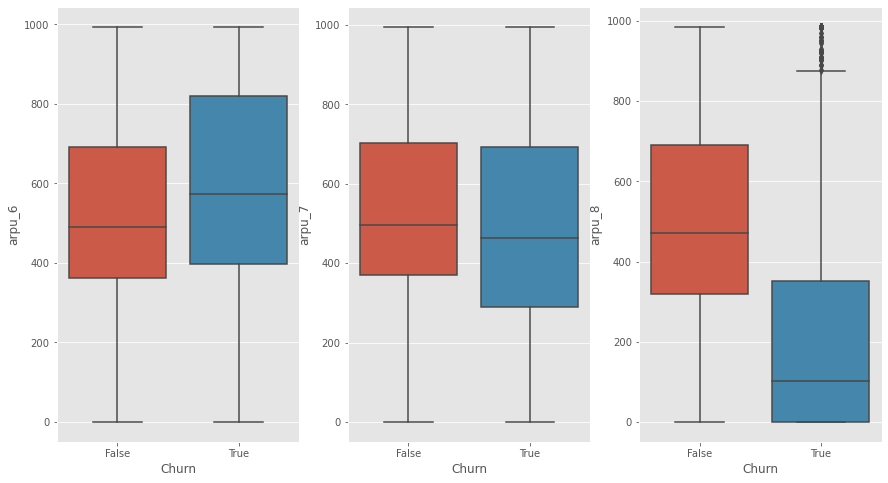

In [952]:
#Checking boxplots of arpu
plt.figure(figsize = (20,8))
arpu_columns = ["arpu_6", "arpu_7", "arpu_8"]
for i, col in enumerate(arpu_columns):
    plt.subplot(1,4,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There is a noticeable drop in the average revenue per user in the month of August. There are a few outliers in the non churn customers which may be due to unpaid bills.

#### Roam_ic and Roam_og

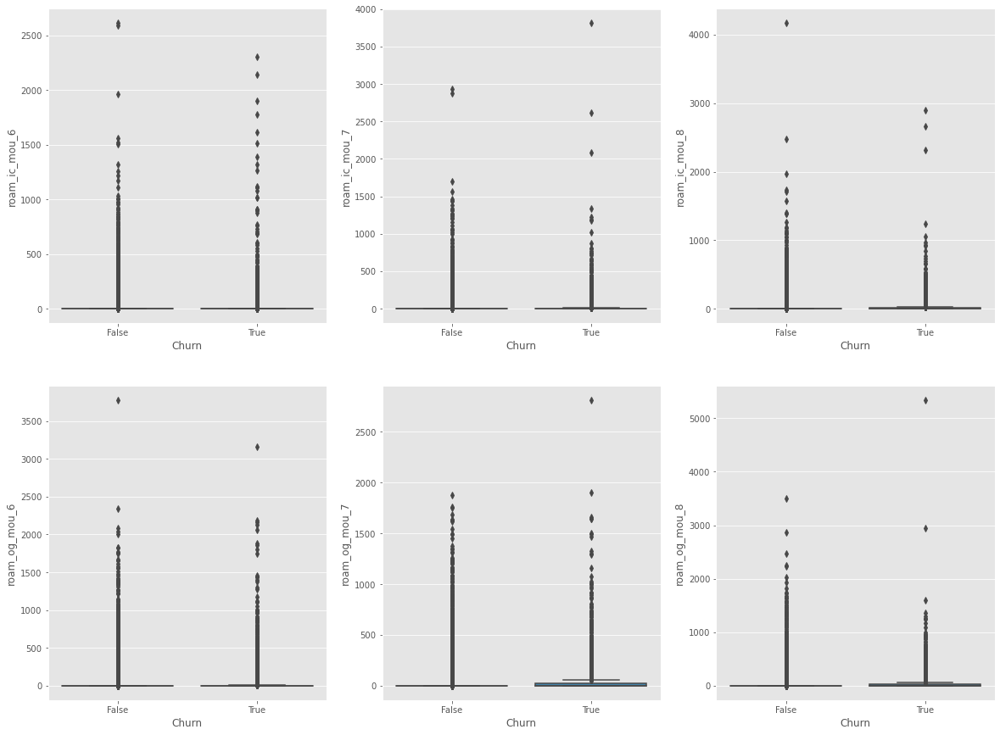

In [953]:
#Checking boxplots of arpu
plt.figure(figsize = (20,15))
roam_columns = ['roam_ic_mou_6','roam_ic_mou_7','roam_ic_mou_8','roam_og_mou_6','roam_og_mou_7','roam_og_mou_8']
for i, col in enumerate(roam_columns):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Roam_ic and Roam_og

In [954]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(roam_columns,df_filtered)

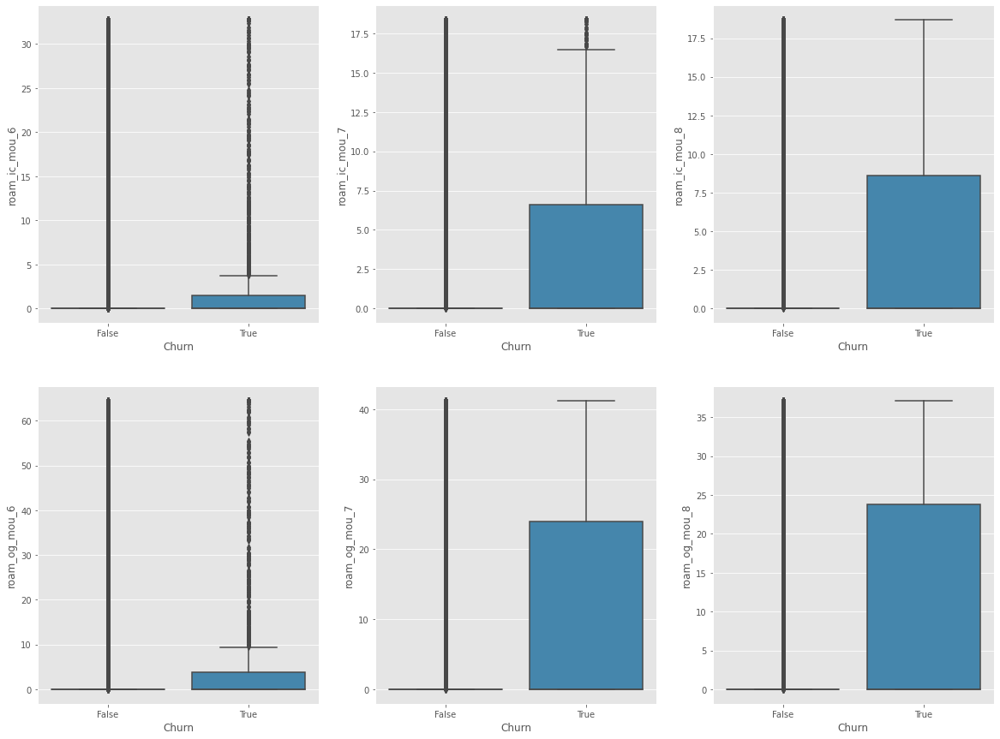

In [955]:
#Checking boxplots of arpu
plt.figure(figsize = (20,15))

for i, col in enumerate(roam_columns):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     The churn customers seem to be on roam more than the non churn customers. The churn customers have considerably higher incoming and outgoing minutes of usage in the  month of July and August

#### Local Outgoing MOU

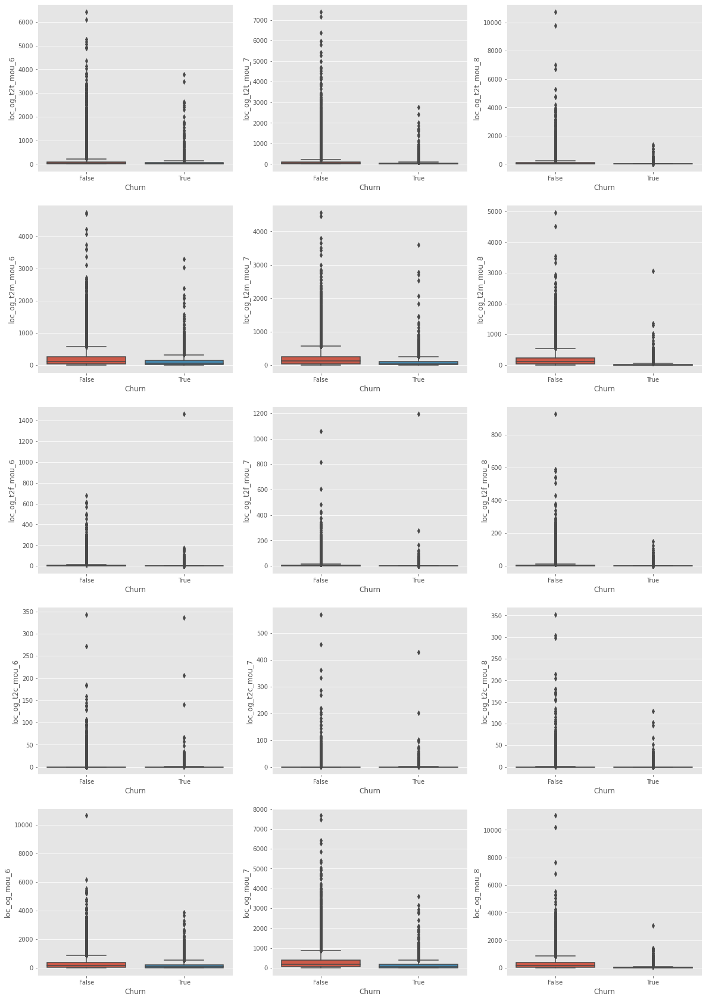

In [956]:
#Checking boxplots of all outgoing
plt.figure(figsize = (20,30))
out_going =["loc_og_t2t_mou_6","loc_og_t2t_mou_7","loc_og_t2t_mou_8",
"loc_og_t2m_mou_6","loc_og_t2m_mou_7","loc_og_t2m_mou_8",
"loc_og_t2f_mou_6","loc_og_t2f_mou_7","loc_og_t2f_mou_8",
"loc_og_t2c_mou_6","loc_og_t2c_mou_7","loc_og_t2c_mou_8",
"loc_og_mou_6","loc_og_mou_7","loc_og_mou_8"]
for i, col in enumerate(out_going):
    plt.subplot(5,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Local Outgoing MOU

In [957]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(out_going,df_filtered)

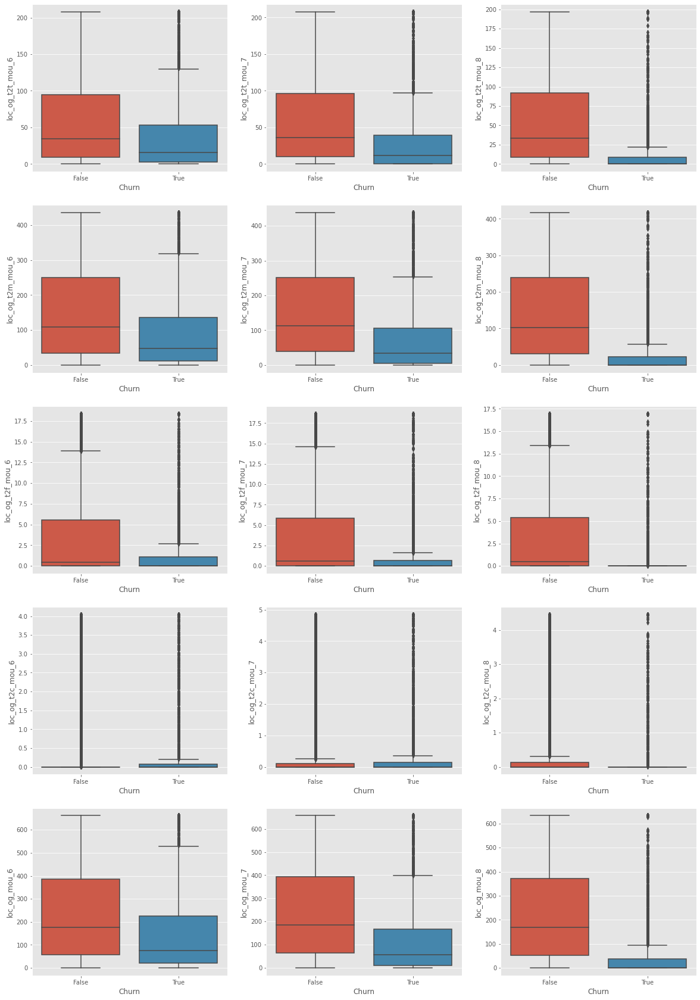

In [958]:
#Checking boxplots of all outgoing
plt.figure(figsize = (20,30))

for i, col in enumerate(out_going):
    plt.subplot(5,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:    For the churn customers 
   *  the local outgoing minutes of usage has gradually reduced in month of July and considerably low in August. 
   * There is an increase in the calls to call centre in the month of July

####  Local Incoming MOU

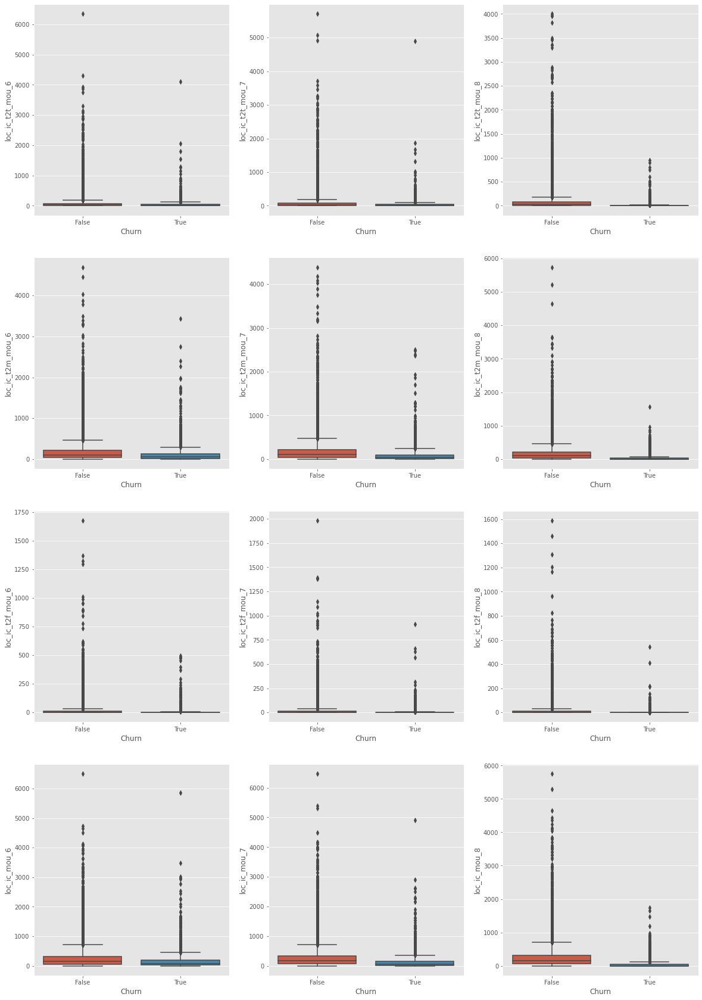

In [959]:
#Checking boxplots of all outgoing
plt.figure(figsize = (20,30))
in_coming =["loc_ic_t2t_mou_6","loc_ic_t2t_mou_7","loc_ic_t2t_mou_8",
            "loc_ic_t2m_mou_6","loc_ic_t2m_mou_7","loc_ic_t2m_mou_8",
            "loc_ic_t2f_mou_6","loc_ic_t2f_mou_7","loc_ic_t2f_mou_8",
            "loc_ic_mou_6","loc_ic_mou_7","loc_ic_mou_8"]
for i, col in enumerate(in_coming):
    plt.subplot(4,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Local Incoming MOU

In [960]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(in_coming,df_filtered)

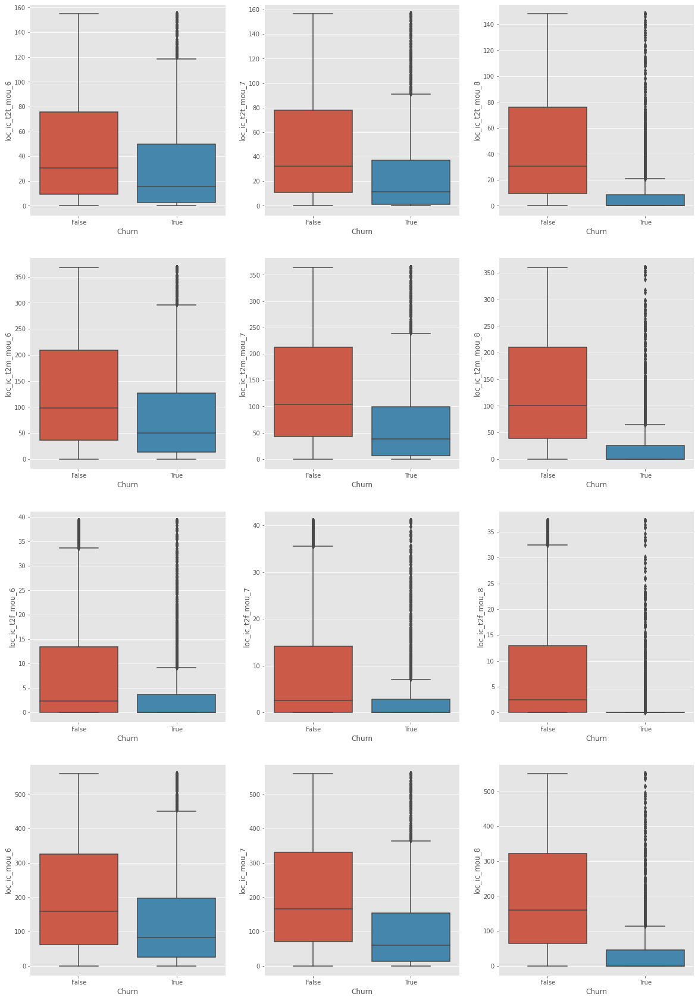

In [961]:
#Checking boxplots of all outgoing
plt.figure(figsize = (20,30))
for i, col in enumerate(in_coming):
    plt.subplot(4,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:    For the churn customers 
   *  the local incoming minutes of usage has gradually reduced in month of July and considerably low in August. 
  

#### Visualzing STD Outgoing MOU

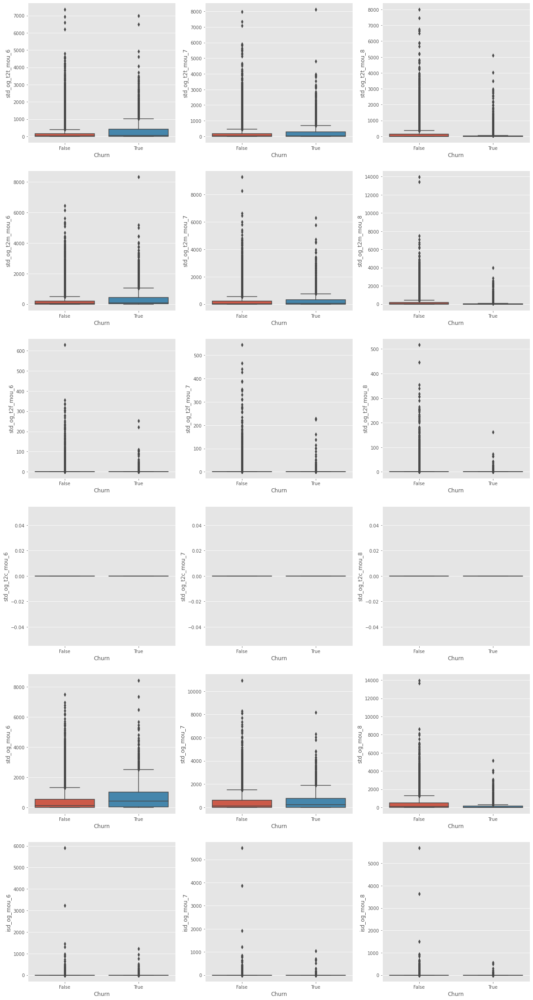

In [962]:
#Checking boxplots of all STD and ISD
plt.figure(figsize = (20,40))
std_isd_cols = ["std_og_t2t_mou_6","std_og_t2t_mou_7","std_og_t2t_mou_8",
"std_og_t2m_mou_6","std_og_t2m_mou_7","std_og_t2m_mou_8",
"std_og_t2f_mou_6","std_og_t2f_mou_7","std_og_t2f_mou_8",
"std_og_t2c_mou_6","std_og_t2c_mou_7","std_og_t2c_mou_8",
"std_og_mou_6","std_og_mou_7","std_og_mou_8",
"isd_og_mou_6","isd_og_mou_7","isd_og_mou_8"]
for i, col in enumerate(std_isd_cols):
    plt.subplot(6,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for STD Outgoing MOU

In [963]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(std_isd_cols,df_filtered)

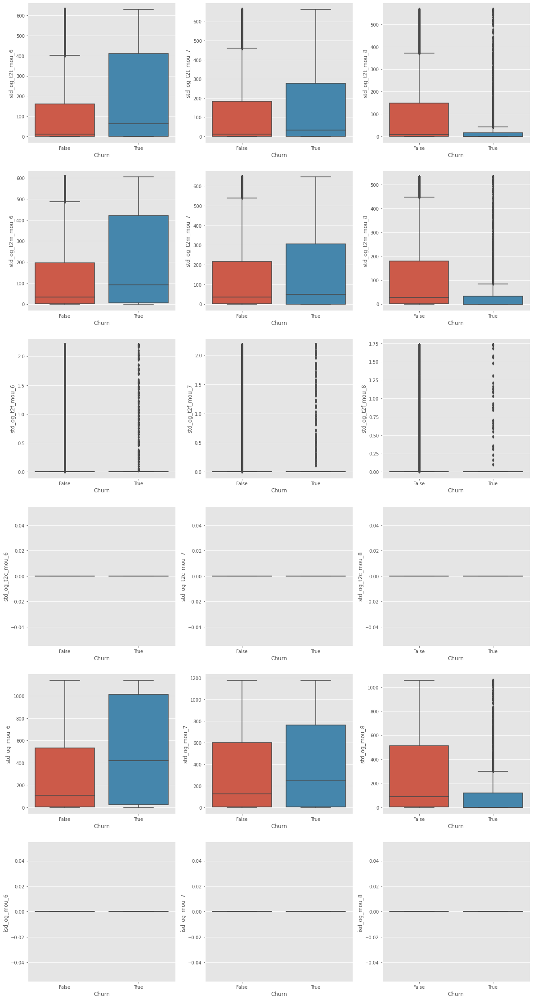

In [964]:
#Checking boxplots of all STD and ISD
plt.figure(figsize = (20,40))

for i, col in enumerate(std_isd_cols):
    plt.subplot(6,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:    For the churn customers 
   *  the std outgoing minutes of usage has gradually reduced in month of July and considerably low in August. This may be connected with the roam mou which was observed earler that increased.
   

#### Visualzing STD Incoming MOU

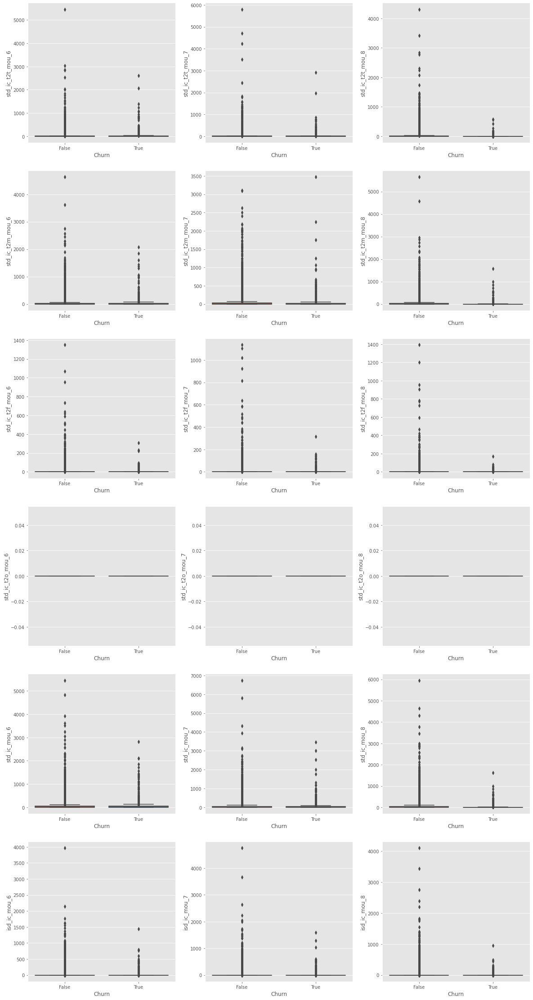

In [965]:
#Checking boxplots of all STD and ISD
plt.figure(figsize = (20,40))
std_isd_cols = ["std_ic_t2t_mou_6","std_ic_t2t_mou_7","std_ic_t2t_mou_8",
                "std_ic_t2m_mou_6","std_ic_t2m_mou_7","std_ic_t2m_mou_8",
                "std_ic_t2f_mou_6","std_ic_t2f_mou_7","std_ic_t2f_mou_8",
                "std_ic_t2o_mou_6","std_ic_t2o_mou_7","std_ic_t2o_mou_8",
                "std_ic_mou_6","std_ic_mou_7","std_ic_mou_8",
               "isd_ic_mou_6","isd_ic_mou_7","isd_ic_mou_8"]
for i, col in enumerate(std_isd_cols):
    plt.subplot(6,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for STD Outgoing MOU

In [966]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(std_isd_cols,df_filtered)

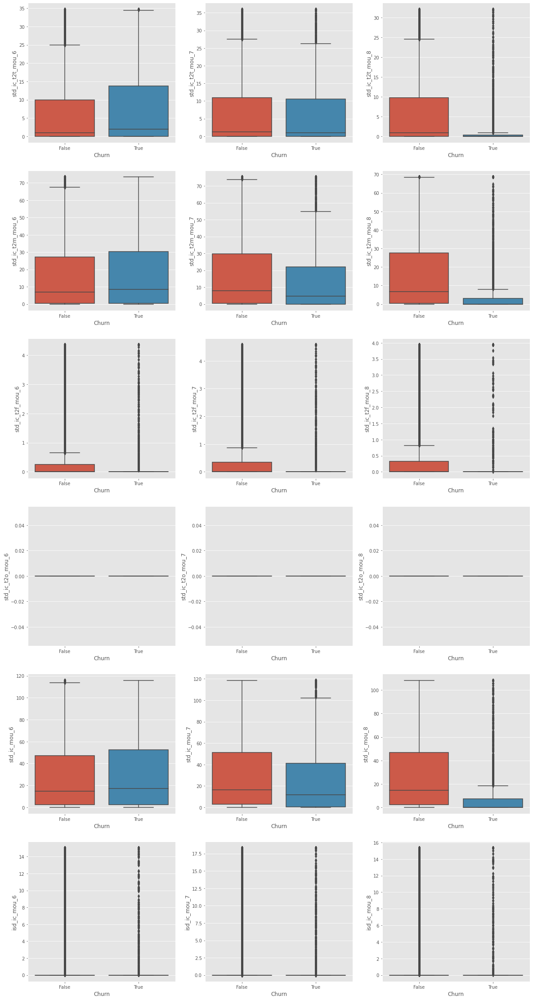

In [967]:
#Checking boxplots of all STD and ISD
plt.figure(figsize = (20,40))

for i, col in enumerate(std_isd_cols):
    plt.subplot(6,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col,whis=1.5)

   ##### Observation:    For the churn customers 
   *  the std incoming minutes of usage has gradually reduced in month of July and considerably low in August. This may be connected with the roam mou which was observed earler that increased.
   

#### Total Recharge For Number

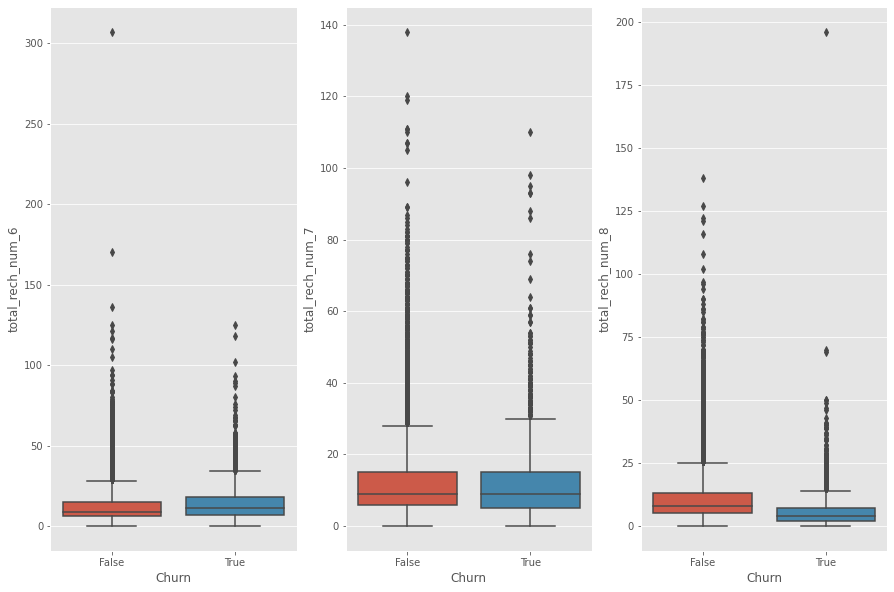

In [968]:
#Checking boxplots of all total recharge for number column
plt.figure(figsize = (15,10))
total_rech_num_cols = ["total_rech_num_6","total_rech_num_7","total_rech_num_8"]
                
for i, col in enumerate(total_rech_num_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Total Recharge For Number

In [969]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(total_rech_num_cols,df_filtered)

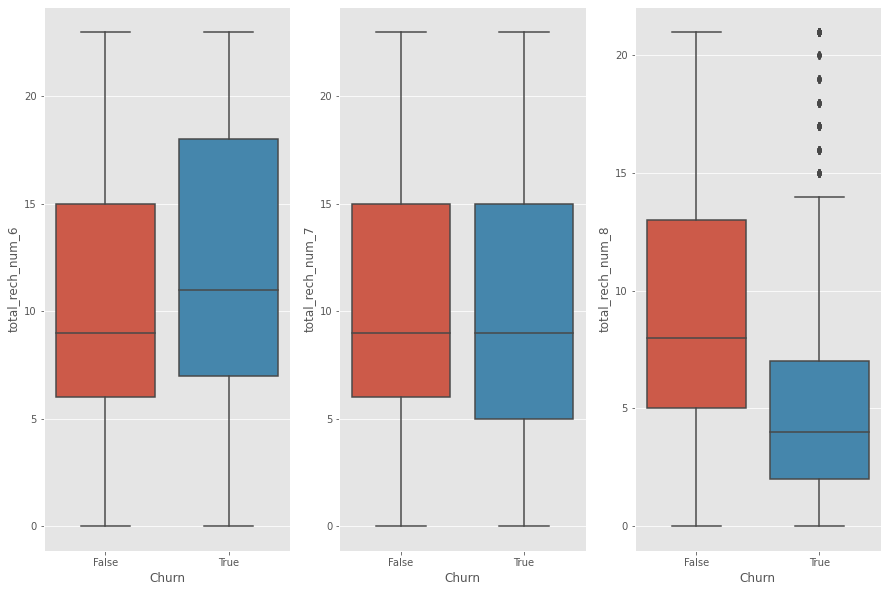

In [970]:
#Checking boxplots of all total recharge for number column
plt.figure(figsize = (15,10))

for i, col in enumerate(total_rech_num_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     For the churn customers there is a gradual decrease with the mean number of recharges lower than that of month of June. It is considerably low for the month of August. For non churn cuatomers it almost remains thesame for all three months

#### Total Recharge Amount

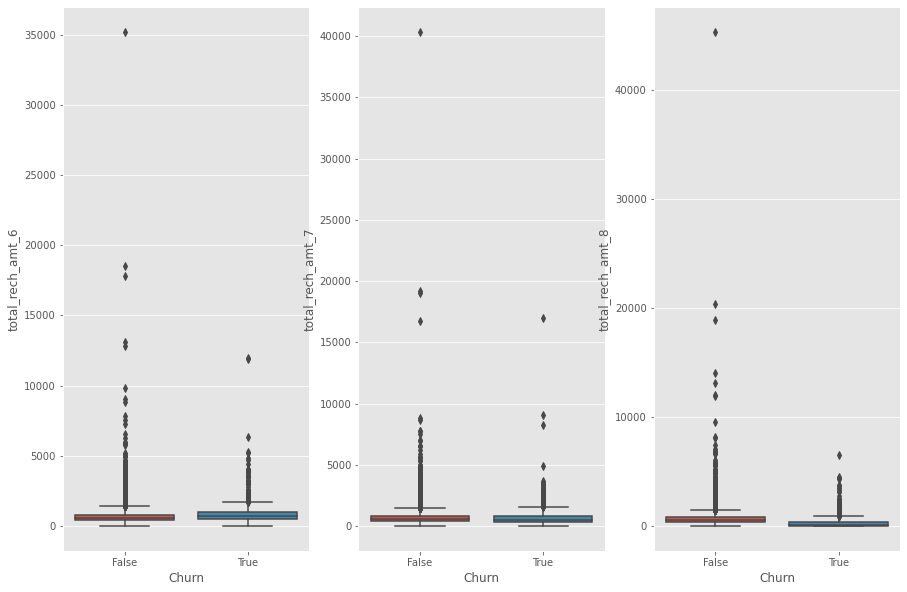

In [971]:
#Checking boxplots of all max recharge column
plt.figure(figsize = (15,10))
total_rech_amt_cols = ["total_rech_amt_6","total_rech_amt_7","total_rech_amt_8"]
                
for i, col in enumerate(total_rech_amt_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Total Recharge Amount

In [972]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(total_rech_amt_cols,df_filtered)

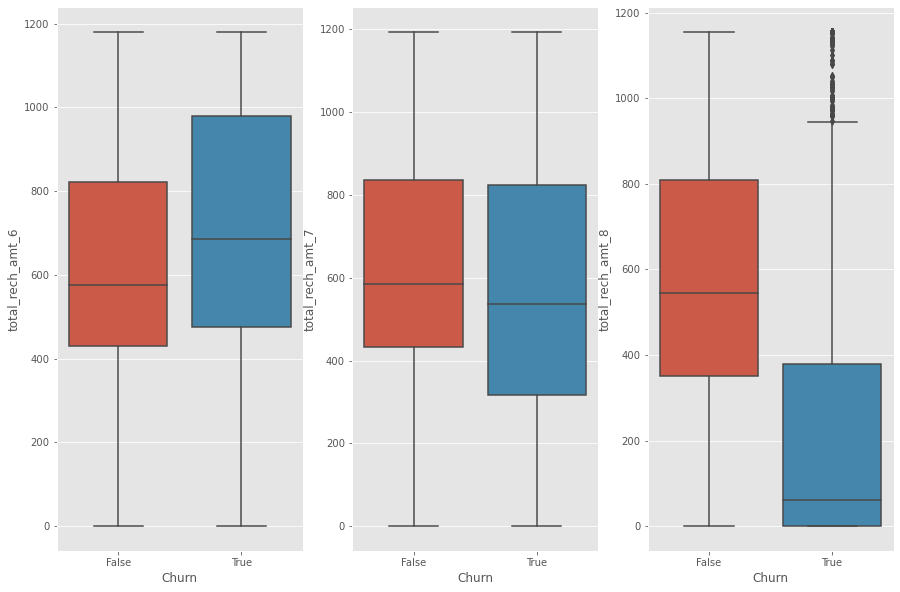

In [973]:
#Checking boxplots of all max recharge column
plt.figure(figsize = (15,10))
                
for i, col in enumerate(total_rech_amt_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     For the churn customers there is a gradual decrease with the mean amount of recahrge lower than that of month of June. It is considerably low for the month of August. For non churn cuatomers it almost remains thesame for all three months

#### Maximum Recharge Amount

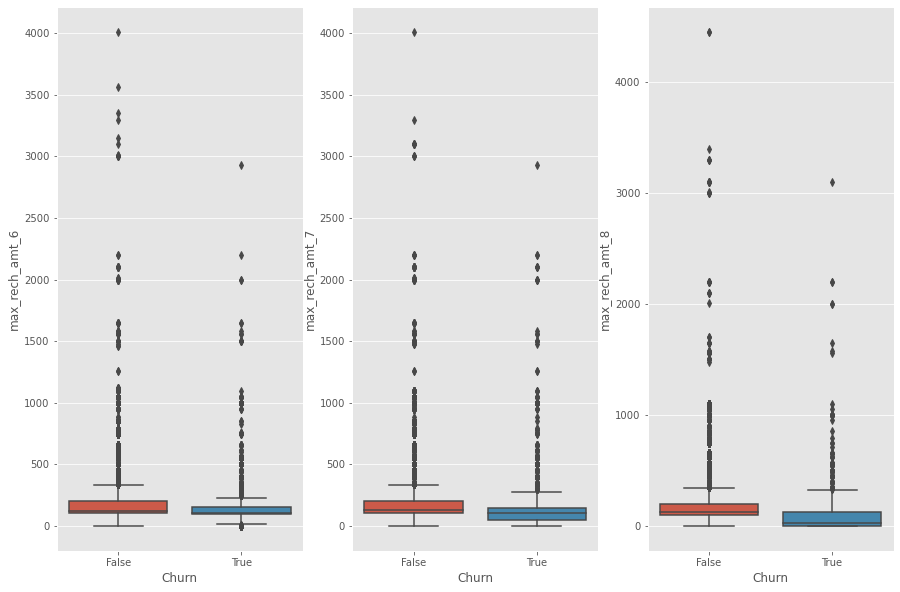

In [974]:
#Checking boxplots of all max recharge amount column
plt.figure(figsize = (15,10))
max_rech_amt_cols = ["max_rech_amt_6","max_rech_amt_7","max_rech_amt_8"]
                
for i, col in enumerate(max_rech_amt_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Maximum Recharge Amount

In [975]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(max_rech_amt_cols,df_filtered)

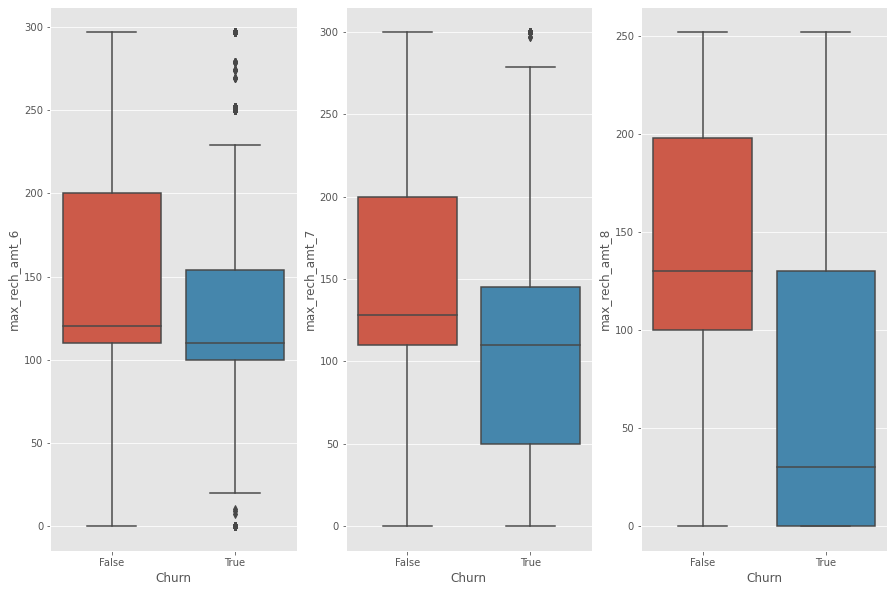

In [976]:
#Checking boxplots of all max recharge amount column
plt.figure(figsize = (15,10))

for i, col in enumerate(max_rech_amt_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     For the churn customers there is a gradual decrease with the mean amount of recahrge lower than that of month of June. It is considerably low for the month of August. For non churn cuatomers it almost remains thesame for all three months

#### Last Day Recharge amount
	


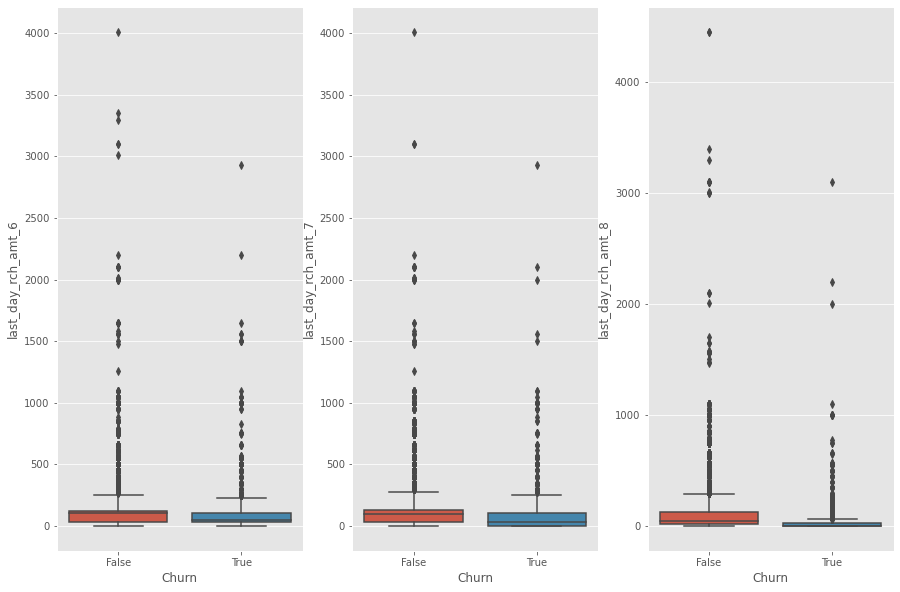

In [977]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (15,10))
lastday_rech_amt_cols = ["last_day_rch_amt_6","last_day_rch_amt_7","last_day_rch_amt_8"]
                
for i, col in enumerate(lastday_rech_amt_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Last Day Recharge amount

In [978]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(lastday_rech_amt_cols,df_filtered)

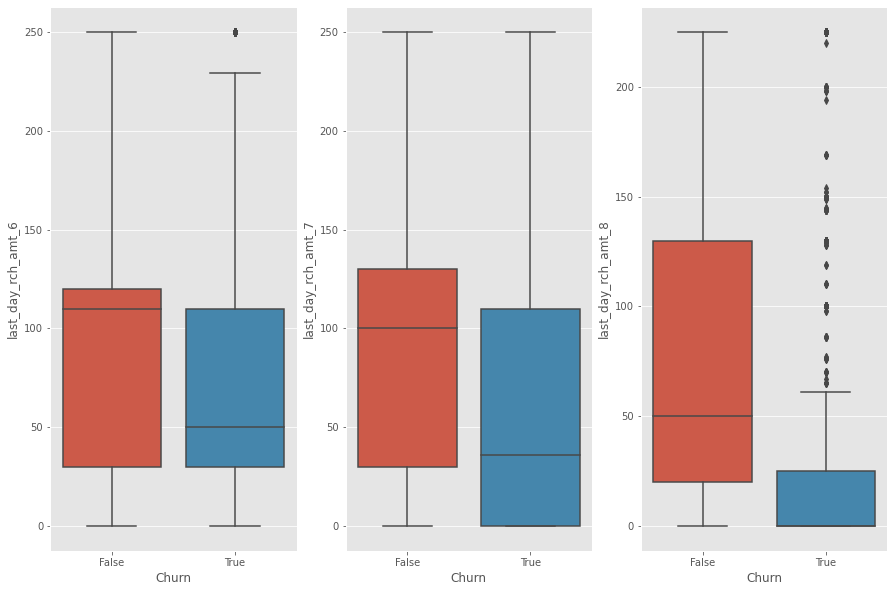

In [979]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (15,10))
  
for i, col in enumerate(lastday_rech_amt_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     For the churn customers there is a gradual decrease with the mean amount of recahrge lower than that of month of June. It is considerably low for the month of August. For non churn cuatomers it almost remains thesame for all three months

#### 2G and 3G Internet usage volume

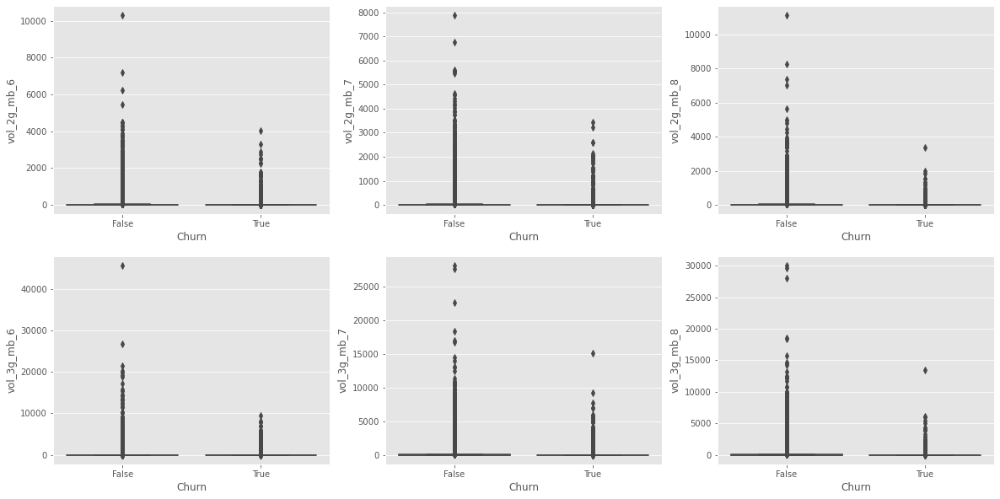

In [980]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
vol_2g3g_mb_cols = ["vol_2g_mb_6","vol_2g_mb_7","vol_2g_mb_8","vol_3g_mb_6","vol_3g_mb_7","vol_3g_mb_8"]
                
for i, col in enumerate(vol_2g3g_mb_cols):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for 2G and 3G Internet usage volume

In [981]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(vol_2g3g_mb_cols,df_filtered)

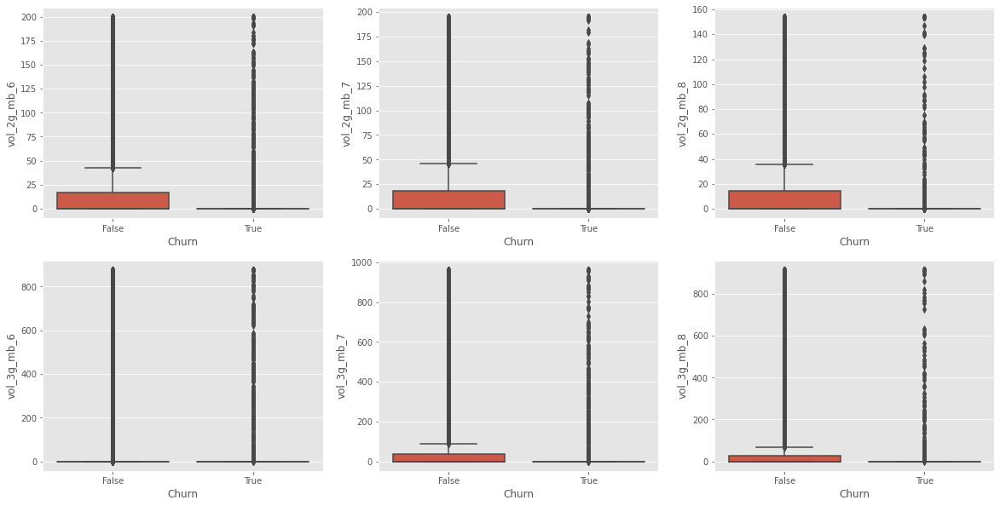

In [982]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))

                
for i, col in enumerate(vol_2g3g_mb_cols):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     For Churn customers the volume of  data has not increased over the three months while the for the non churn customers the volume has increased slightly.

#### Average Revenue of 2g and 3g network per user

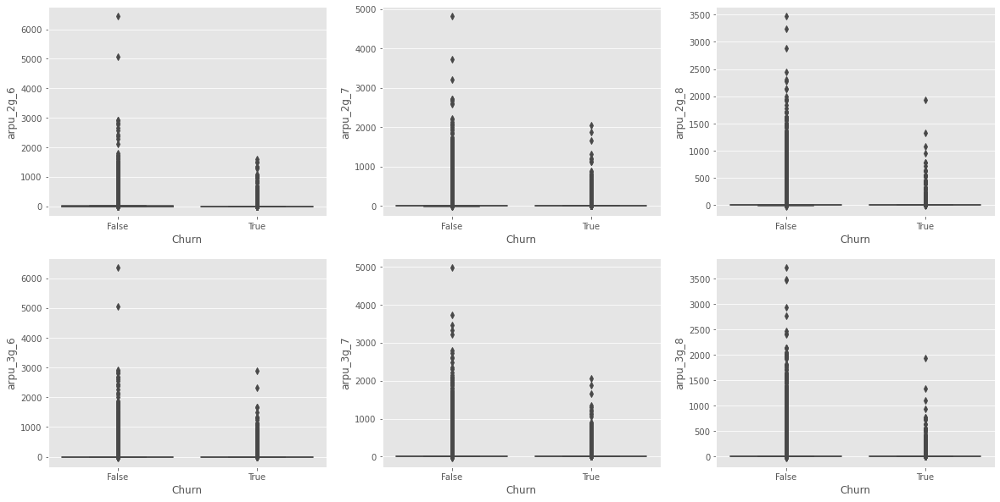

In [983]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
arpu_2g3g_mb_cols = ["arpu_2g_6","arpu_2g_7","arpu_2g_8","arpu_3g_6","arpu_3g_7","arpu_3g_8"]
                
for i, col in enumerate(arpu_2g3g_mb_cols):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Average Revenue of 2g and 3g network per user

In [984]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(arpu_2g3g_mb_cols,df_filtered)

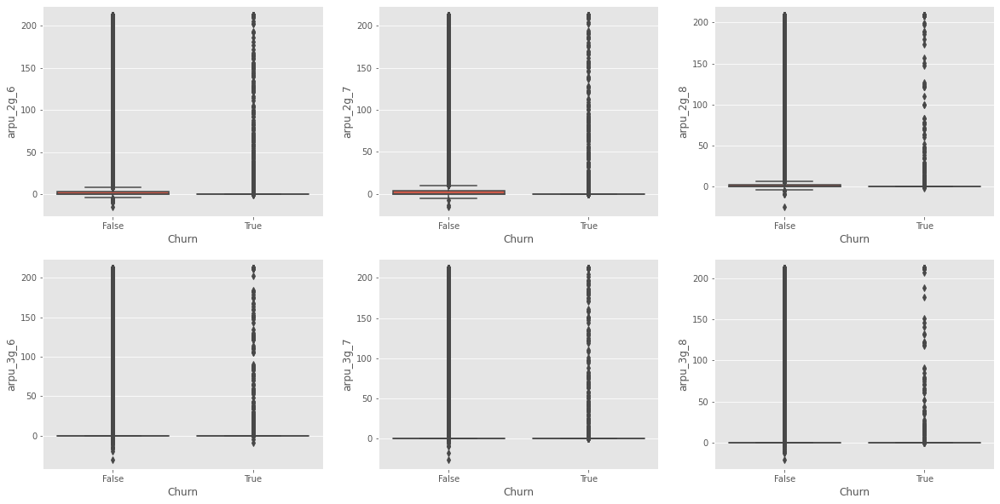

In [985]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))

for i, col in enumerate(arpu_2g3g_mb_cols):
    plt.subplot(2,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     For Churn customers the arpu has not increased over the three months while arpu for the non churn customers the volume has increased slightly and some neagtive values are present which can be unpaid bills.
   

#### Monthly Subscription

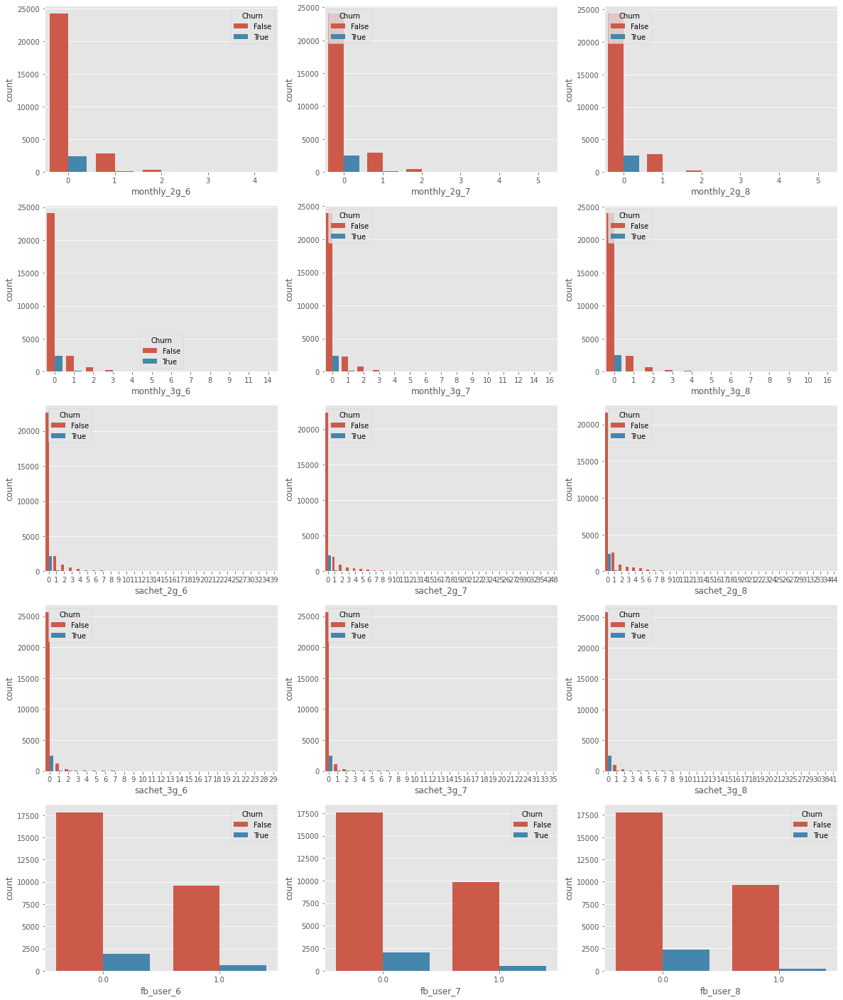

In [986]:
#Checking what packages can show any pattern for churn
plt.figure(figsize = (20,25))
sub_user_cols = ["monthly_2g_6","monthly_2g_7","monthly_2g_8",
                 "monthly_3g_6","monthly_3g_7","monthly_3g_8",
                "sachet_2g_6","sachet_2g_7","sachet_2g_8",
                 "sachet_3g_6","sachet_3g_7","sachet_3g_8",
                 "fb_user_6","fb_user_7","fb_user_8"]

                
for i, col in enumerate(sub_user_cols):
    plt.subplot(5,3,i+1)
    sns.countplot(x=col,hue ="Churn", data=df_filtered)
    

In [987]:
df_churn = df_filtered[df_filtered.Churn == True]
df_not_churn = df_filtered[df_filtered.Churn == False]

In [988]:
df_not_churn["monthly_2g_6"].value_counts()

0    24228
1     2825
2      334
3       26
4        5
Name: monthly_2g_6, dtype: int64

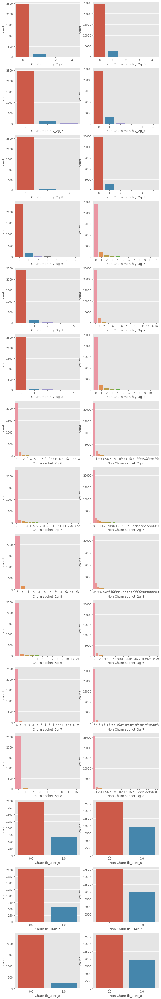

In [989]:
# plt.style.use("ggplot")
plt.figure(figsize=(10,70))
sub_user_cols = ["monthly_2g_6","monthly_2g_7","monthly_2g_8",
                 "monthly_3g_6","monthly_3g_7","monthly_3g_8",
                "sachet_2g_6","sachet_2g_7","sachet_2g_8",
                 "sachet_3g_6","sachet_3g_7","sachet_3g_8",
                 "fb_user_6","fb_user_7","fb_user_8"]
i=0
for col in sub_user_cols:
    plt.subplot(15,2,i+1)
    ax = sns.countplot(x=col, data=df_churn)
    ax.set(xlabel="Churn "+col)
    plt.subplot(15,2,i+2)
    ax = sns.countplot(x=col, data=df_not_churn)
    ax.set(xlabel="Non Churn "+col)
    i=i+2


#### Age on network

In [990]:
df_filtered["aon"].describe()

count    30011.000000
mean      1264.064776
std        975.263117
min        180.000000
25%        480.000000
50%        914.000000
75%       1924.000000
max       4321.000000
Name: aon, dtype: float64

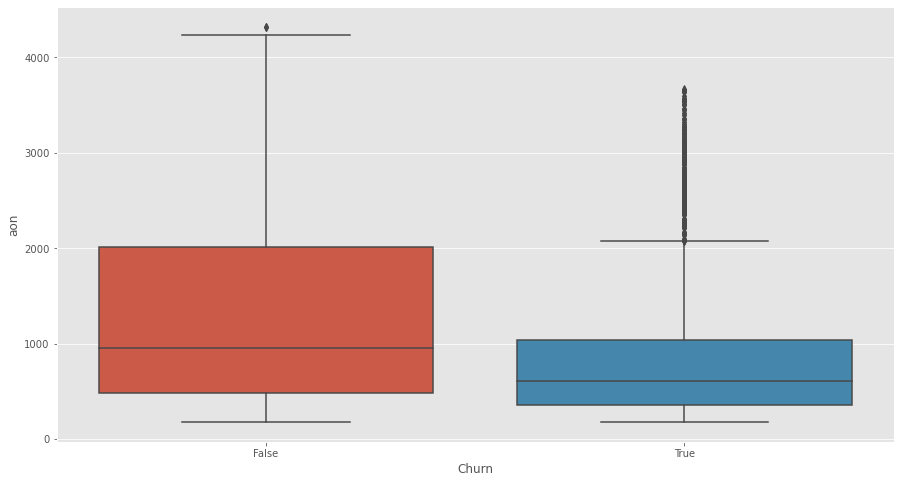

In [991]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (15,8))
sns.boxplot(data =df_filtered,x='Churn', y= "aon")

##### Observation The mean age on network of the customer who is going to churn is  lower than the non-churn customer. The average age on network of  customer is around 500 days. If average age is above 1000 days it looks less likely that he will churn.

#### Volume based Calls

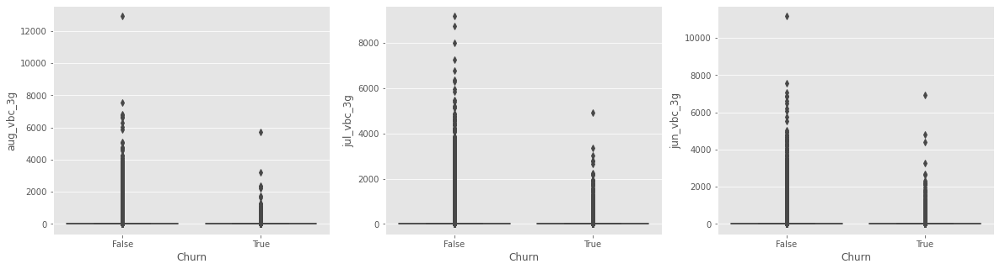

In [992]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,5))
vbc_cols = ["aug_vbc_3g","jul_vbc_3g","jun_vbc_3g"]
                
for i, col in enumerate(vbc_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

   ##### Observation:     There are a lot of outliers they have to be handled to see any hidden patterns

##### Handling Outliers for Volume based Calls

In [993]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(vbc_cols,df_filtered)

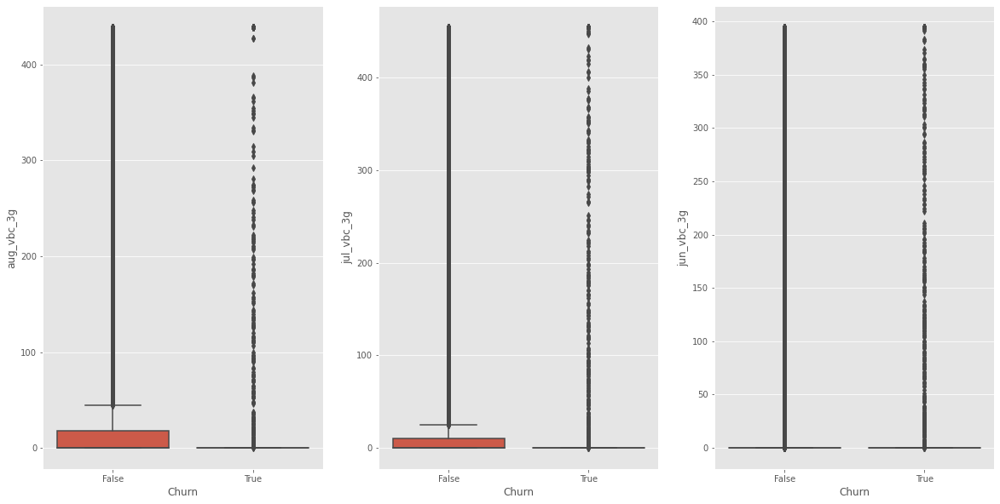

In [994]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))

for i, col in enumerate(vbc_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

#####  Observation: Not much inference could be drawn from the volume based calls

### Derived Variables

#### Total Incoming Minutes of Usage

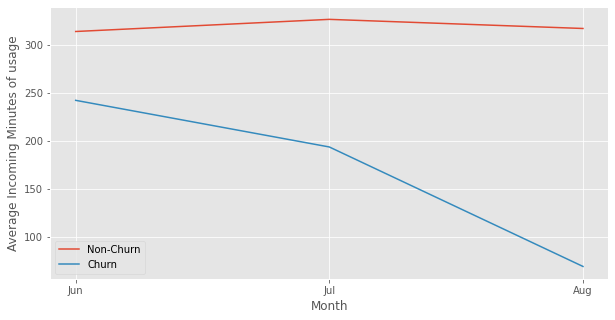

In [995]:

incoming_col = ['total_ic_mou_6','total_ic_mou_7','total_ic_mou_8']
mou_churn_df=df_filtered.groupby(['Churn'])[incoming_col].mean()
transpose_mou_churn_df=df_filtered.groupby(['Churn'])[incoming_col].mean().T
fig, ax = plt.subplots(figsize=(10,5))
plt.plot(transpose_mou_churn_df)
plt.legend(['Non-Churn', 'Churn'])
ax.set_xticklabels(['Jun','Jul','Aug'])
plt.xlabel("Month")
plt.ylabel("Average Incoming Minutes of usage")
plt.show()


##### Observation: For Churners, Incoming call drops after the month of June.

#### Total Outgoing Minutes of Usage

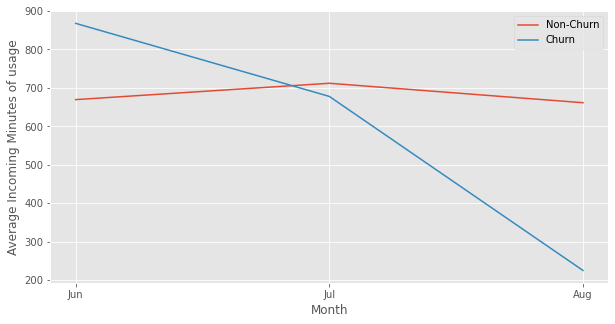

In [996]:
outgoing_col = ['total_og_mou_6','total_og_mou_7','total_og_mou_8']
#mou_churn_df=df_filtered.groupby(['Churn'])[outgoing_col].mean()
avg_outgoing_mou=df_filtered.groupby(['Churn'])[outgoing_col].mean().T
fig, ax = plt.subplots(figsize=(10,5))
plt.plot(avg_outgoing_mou)
plt.legend(['Non-Churn', 'Churn'])
ax.set_xticklabels(['Jun','Jul','Aug'])
plt.xlabel("Month")
plt.ylabel("Average Incoming Minutes of usage")
plt.show()

##### Observation Average Incoming minutes of usage have been steadily decreasing and dropped considerably in August

#### Ratio of local outgoing calls to total outgoing calls

In [997]:
#Deriving the variable loc:roam ratio 
total_og = df_filtered.filter(like ="total_og_mou")
total_og.head()

,total_og_mou_6,total_og_mou_7,total_og_mou_8
7,487.53,609.24,350.16
8,508.36,431.66,171.56
13,907.09,192.41,1015.26
16,346.81,286.01,233.38
17,1249.53,0.81,0.00


In [998]:

loc_og = df_filtered.filter(like ="loc_og_mou")
df_filtered[["ratio_local_to_total_6"]]=loc_og["loc_og_mou_6"]/total_og["total_og_mou_6"]
df_filtered[["ratio_local_to_total_7"]]=loc_og["loc_og_mou_7"]/total_og["total_og_mou_7"]
df_filtered[["ratio_local_to_total_8"]]=loc_og["loc_og_mou_8"]/total_og["total_og_mou_8"]
df_filtered[["ratio_local_to_total_6","ratio_local_to_total_7","ratio_local_to_total_8"]].head()

,ratio_local_to_total_6,ratio_local_to_total_7,ratio_local_to_total_8
7,0.865916,0.876354,0.730495
8,0.743745,0.667609,0.367452
13,0.226339,0.277948,0.348669
16,0.910902,0.753960,0.882381
17,0.078061,0.000000,NaN


In [999]:
#Since there are NaN in the derived columns as some ofthe records have total og calls as 0 they are imputed with 0
df_filtered[["ratio_local_to_total_6","ratio_local_to_total_7","ratio_local_to_total_8"]] = df_filtered[["ratio_local_to_total_6","ratio_local_to_total_7","ratio_local_to_total_8"]].fillna(0)

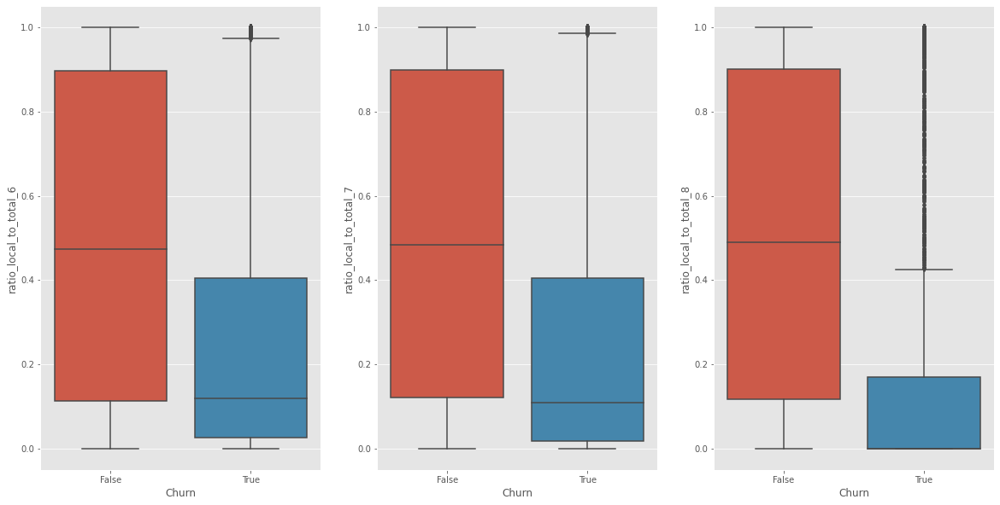

In [1000]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
ratio_cols = ["ratio_local_to_total_6","ratio_local_to_total_7","ratio_local_to_total_8"]
for i, col in enumerate(ratio_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

##### Observation For Churners the median of Ratio of local outgoing calls to total calls is lower than for 25% for non_churners. In the month of August the IQR of churners are below the value of first qaurtile.

#### Ratio of STD outgoing calls to total outgoing calls

In [1001]:
std_og = df_filtered.filter(like ="std_og_mou")

df_filtered[["ratio_std_to_total_6"]]=std_og["std_og_mou_6"]/total_og["total_og_mou_6"]
df_filtered[["ratio_std_to_total_7"]]=std_og["std_og_mou_7"]/total_og["total_og_mou_7"]
df_filtered[["ratio_std_to_total_8"]]=std_og["std_og_mou_8"]/total_og["total_og_mou_8"]
df_filtered[["ratio_std_to_total_6","ratio_std_to_total_7","ratio_std_to_total_8"]].head()

,ratio_std_to_total_6,ratio_std_to_total_7,ratio_std_to_total_8
7,0.124833,0.123334,0.222298
8,0.256236,0.332391,0.572861
13,0.773661,0.722052,0.645332
16,0.089069,0.234572,0.092253
17,0.913087,1.000000,NaN


In [1002]:
#Since there are NaN in the derived columns as some ofthe records have total og calls as 0 they are imputed with 0
df_filtered[["ratio_std_to_total_6","ratio_std_to_total_7","ratio_std_to_total_8"]] = df_filtered[["ratio_std_to_total_6","ratio_std_to_total_7","ratio_std_to_total_8"]].fillna(0)

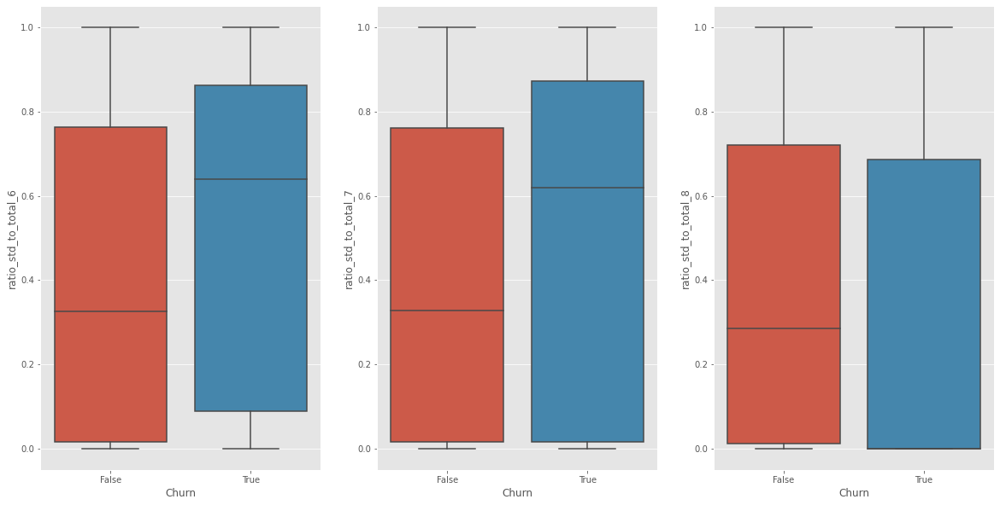

In [1003]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
ratio_cols = ["ratio_std_to_total_6","ratio_std_to_total_7","ratio_std_to_total_8"]
for i, col in enumerate(ratio_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

#### Ratio of Roaming outgoing calls to total outgoing calls

In [1004]:
std_og = df_filtered.filter(like ="roam_og_mou")

df_filtered[["ratio_roam_to_total_6"]]=std_og["roam_og_mou_6"]/total_og["total_og_mou_6"]
df_filtered[["ratio_roam_to_total_7"]]=std_og["roam_og_mou_7"]/total_og["total_og_mou_7"]
df_filtered[["ratio_roam_to_total_8"]]=std_og["roam_og_mou_8"]/total_og["total_og_mou_8"]
df_filtered[["ratio_roam_to_total_6","ratio_roam_to_total_7","ratio_roam_to_total_8"]].head()

,ratio_roam_to_total_6,ratio_roam_to_total_7,ratio_roam_to_total_8
7,0.048694,0.020665,0.105980
8,0.000000,0.000000,0.000000
13,0.008797,0.183255,0.001418
16,0.000000,0.062026,0.000000
17,0.000000,10.444444,inf


In [1005]:
#Since there are NaN in the derived columns as some ofthe records have total og calls as 0 they are imputed with 0
df_filtered[["ratio_roam_to_total_6","ratio_roam_to_total_7","ratio_roam_to_total_8"]] = df_filtered[["ratio_roam_to_total_6","ratio_roam_to_total_7","ratio_roam_to_total_8"]].fillna(0)

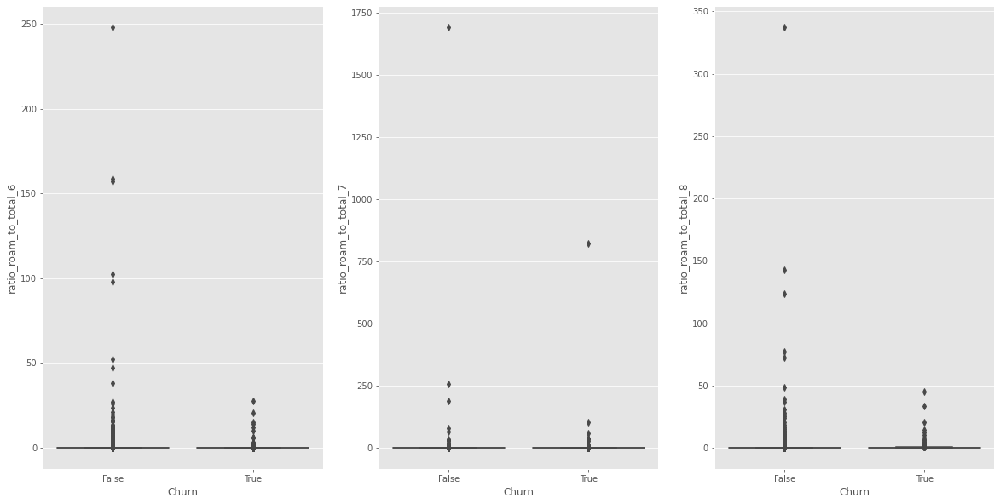

In [1006]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
ratio_cols = ["ratio_roam_to_total_6","ratio_roam_to_total_7","ratio_roam_to_total_8"]
for i, col in enumerate(ratio_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

##### Handling Outliers for Ratio of Roaming outgoing calls to total outgoing calls

In [1007]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(ratio_cols,df_filtered)

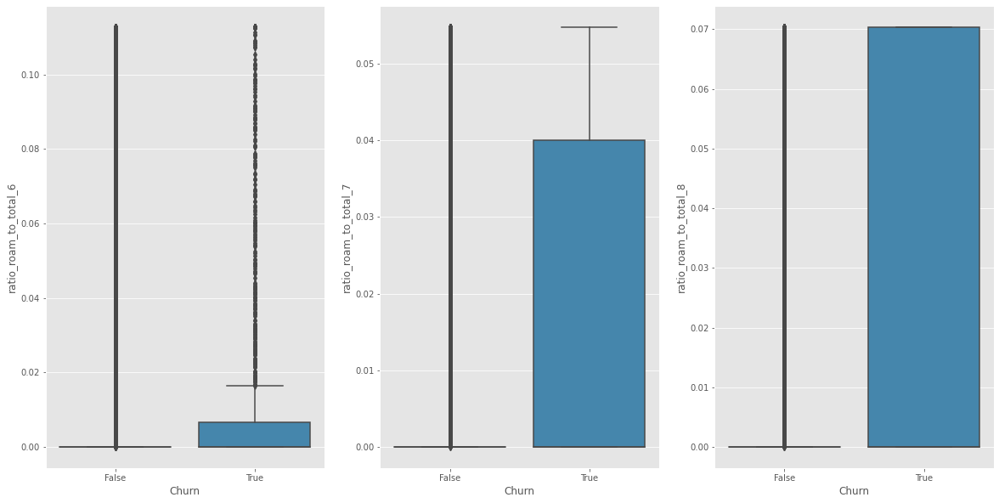

In [1008]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))

for i, col in enumerate(ratio_cols):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

#####  Observation: The roaming minutes of usage for churners has gradually increased in the month of July and August. While non_churners it is very low.

#### Total Minutes of Usage (incoming and outgoing)

In [1009]:
df_filtered["total_mou_6"] = df_filtered["total_og_mou_6"] + df_filtered["total_ic_mou_6"]
df_filtered["total_mou_7"] = df_filtered["total_og_mou_7"] + df_filtered["total_ic_mou_7"]
df_filtered["total_mou_8"] = df_filtered["total_og_mou_8"] + df_filtered["total_ic_mou_8"]


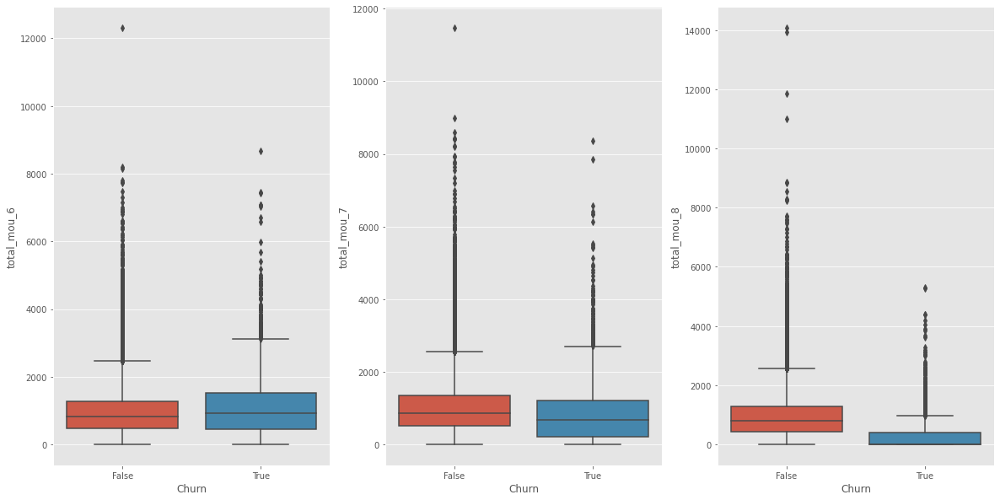

In [1010]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
total_mou = ["total_mou_6","total_mou_7","total_mou_8"]
for i, col in enumerate(total_mou):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

##### Handling Outliers for Ratio of Roaming outgoing calls to total outgoing calls

In [1011]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(total_mou,df_filtered)

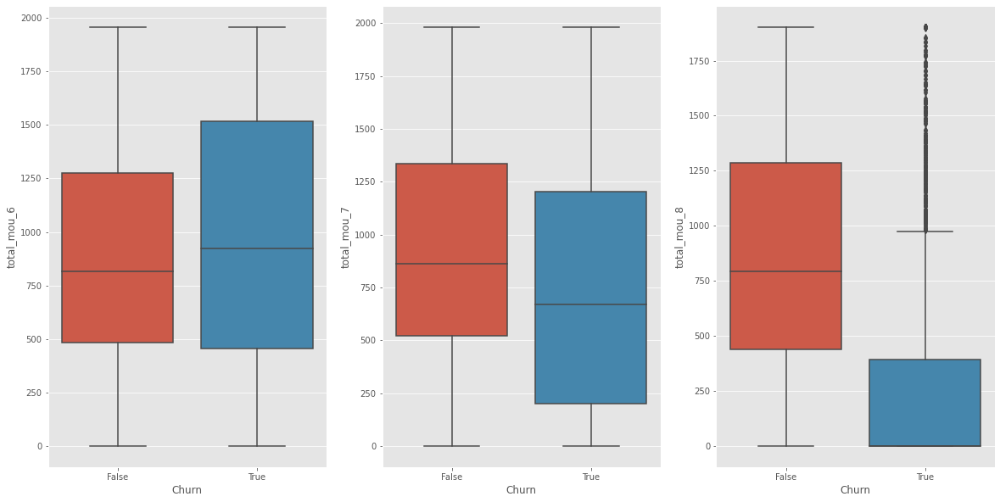

In [1012]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
total_mou = ["total_mou_6","total_mou_7","total_mou_8"]
for i, col in enumerate(total_mou):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

#####  Observation: The total minutes of usage for churners has gradually decreased in the month of July and drastically in August. While non_churners remains almost unchanged

#### Average Recharge Amount

In [1013]:
#Taking ratio of total recharge amount by total recharge number to get the average recharge amount
df_filtered["avg_rch_amt_6"] = df_filtered["total_rech_amt_6"] / df_filtered["total_rech_num_6"]
df_filtered["avg_rch_amt_7"] = df_filtered["total_rech_amt_7"] / df_filtered["total_rech_num_7"]
df_filtered["avg_rch_amt_8"] = df_filtered["total_rech_amt_8"] / df_filtered["total_rech_num_8"]
df_filtered[["avg_rch_amt_6","avg_rch_amt_7","avg_rch_amt_8"]].isna().sum()

avg_rch_amt_6     62
avg_rch_amt_7    114
avg_rch_amt_8    594
dtype: int64

In [1014]:
#Since there are NaN in the derived columns as some ofthe records have total og calls as 0 they are imputed with 0
df_filtered[["avg_rch_amt_6","avg_rch_amt_7","avg_rch_amt_8"]] = df_filtered[["avg_rch_amt_6","avg_rch_amt_7","avg_rch_amt_8"]].fillna(0)

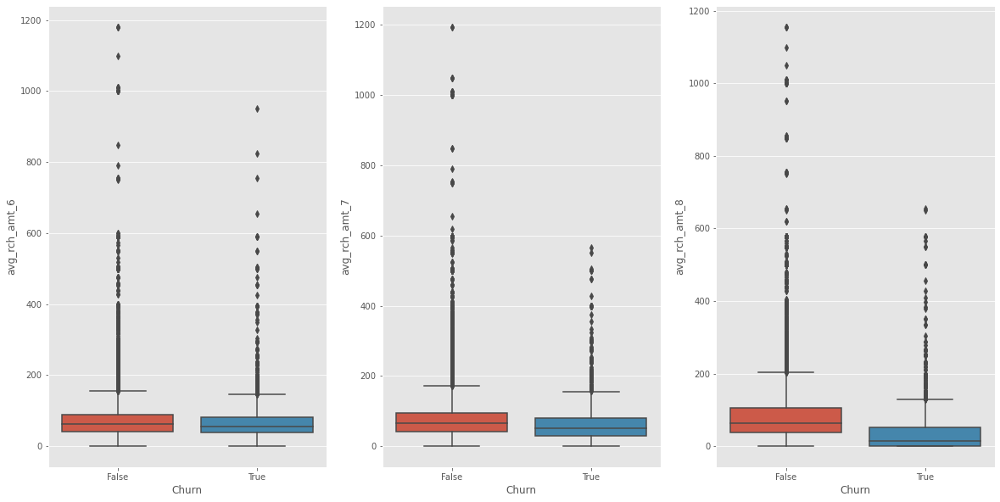

In [1015]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
avg_rch = ["avg_rch_amt_6","avg_rch_amt_7","avg_rch_amt_8"]
for i, col in enumerate(avg_rch):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

In [1016]:
# Using the helper function to remove outliers
df_filtered = func_outlier_treatment(avg_rch,df_filtered)

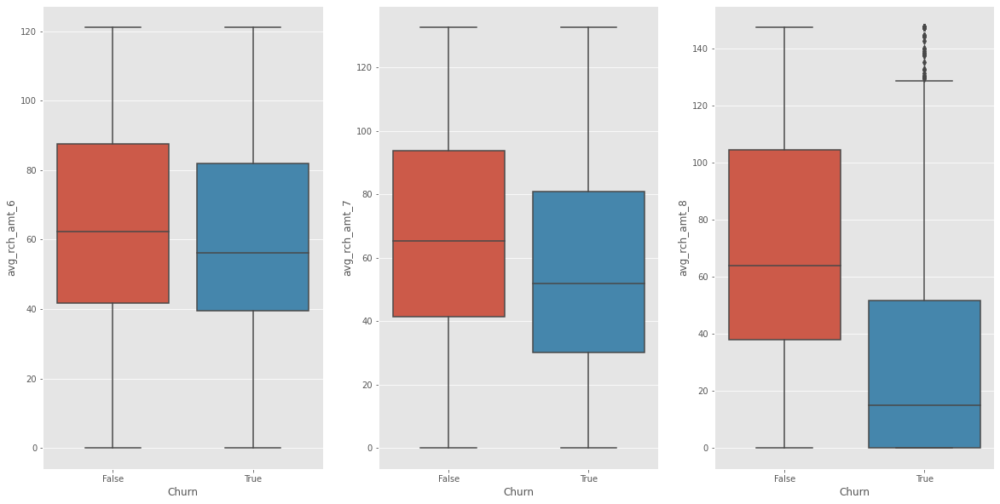

In [1017]:
#Checking boxplots of all last day recharge amount
plt.figure(figsize = (20,10))
avg_rch = ["avg_rch_amt_6","avg_rch_amt_7","avg_rch_amt_8"]
for i, col in enumerate(avg_rch):
    plt.subplot(1,3,i+1)
    sns.boxplot(data =df_filtered,x='Churn', y= col)

##### Observation The median for the average recharge amount for churners is slightly lower in July then June. In August the median is lower than 25% quantile of non churners

### Binning the packages bought and Creating Dummy Variable

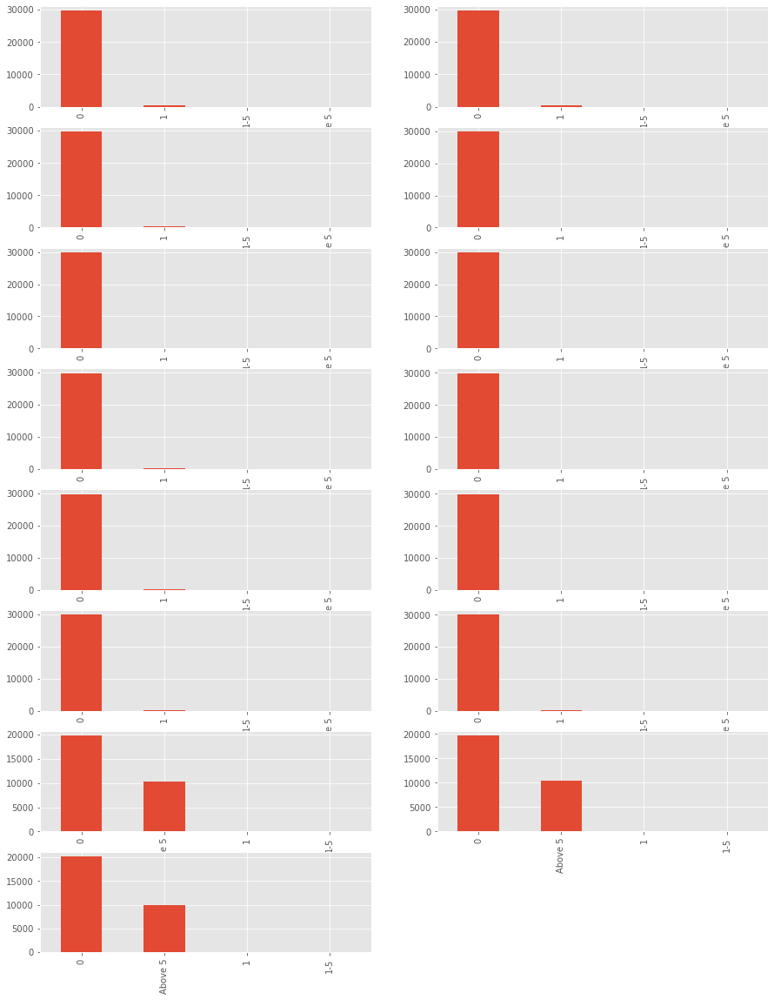

In [1018]:
for i,col in enumerate(sub_user_cols):
     df_filtered[col + 'bin']= pd.cut(df_filtered[col],bins=4,labels=['0','1','1-5','Above 5'])       
bins_col = df_filtered.filter(like="bin").columns   
plt.figure(figsize=(15,20))
for i,col in enumerate(bins_col):     
    plt.subplot(8,2,i+1)
    df_filtered[col].value_counts().plot(kind='bar')

In [1019]:
#Creating dummy variables for packages data
for i,col in enumerate(bins_col):
    dummy1 = pd.get_dummies(df_filtered[col], drop_first=True)
    df_filtered =pd.concat([df_filtered, dummy1], axis=1) 

df_filtered = df_filtered.drop(bins_col, axis= 1)

### Checking for Multicollinearity

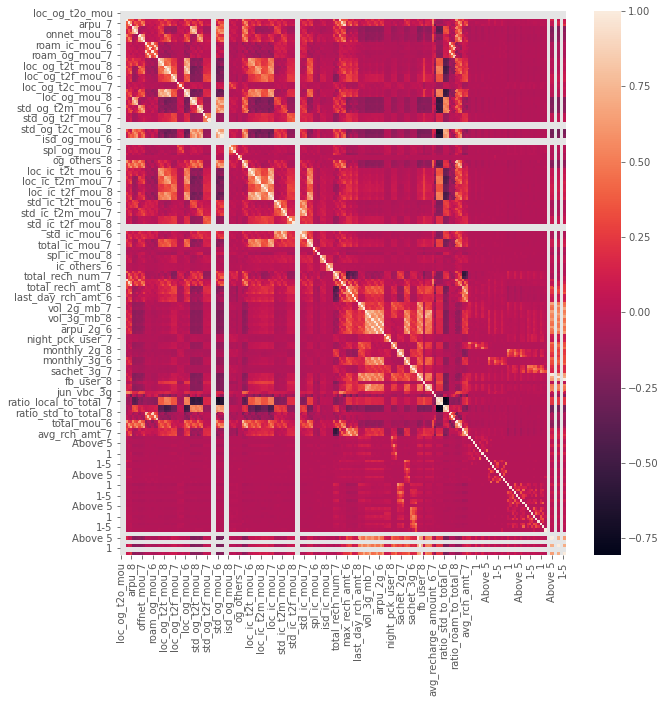

In [1020]:
plt.figure(figsize=(10,10))
sns.heatmap(df_filtered.corr())

###### Observation
There is a lot of multicollinearity which will be addressed later with RFE and PCA later on in the notebook. 

### Splitting the data into train and test

In [1021]:
#Seperating target variable Churn
y=df_filtered.pop("Churn")
X=df_filtered

In [1022]:
#Using stratify since it is an imbalanced data.
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size =.30, stratify=y,random_state=100)

In [1023]:
#Checking the size of the data
print("X_train shape: ", X_train.shape)
print("X_test shape: ", X_test.shape)
print("y_train shape: ", y_train.shape)
print("y_train shape: ", y_test.shape)


X_train shape:  (21007, 206)
X_test shape:  (9004, 206)
y_train shape:  (21007,)
y_train shape:  (9004,)


In [1024]:
#Checking if it was a stratified split since this is imbalnced data.
# It is made sure that test and train have the same ratio  in the Churn cases 
print("y_train composition",y_train.value_counts(normalize=True))
print("y_test composition",y_train.value_counts(normalize=True))

y_train composition False    0.9136
True     0.0864
Name: Churn, dtype: float64
y_test composition False    0.9136
True     0.0864
Name: Churn, dtype: float64


### Scaling

In [1025]:
#Using a standard sclaer since we will be using linear models and PCA
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [1026]:
print("count of churners '1': {}".format(sum(y_train == 1)))
print("count of non-churners '0': {} \n".format(sum(y_train == 0)))

count of churners '1': 1815
count of non-churners '0': 19192 



#### There is an imbalance in the data.


Standard ML techniques such as Decision Tree and Logistic Regression have a bias towards the majority class, and they tend to ignore the minority class. If we have imbalanced data distribution in our dataset then our model becomes more prone to the case when minority class has very lesser recall. There are different ML techniques to handle this imbalance.


The workflow of the notebook is as follows:

    Approach 1. 
    1. The models are built without handling the data imbalance as a whole data set instead option in individual models are used.
    2. Classification Report of models with train and test data are compared
    3. ROC AUC curves are compared for both train and test data.
    
    Approach 2.
    1. The models are built after handling the data imbalance.
    2. Classification Report of models with train and test data are compared
    3. ROC AUC curves are compared for both train and test data.
    
    The above models are used to extract feature importance and give suggestion to the telecom company
    
    Approach 3.
    1. The models are built after handling the data imbalance and using PCA to reduce multicollinarity.
    2. Classification Report of models with train and test data are compared
    3. ROC AUC curves are compared for both train and test data.
    
    The above models are used to for acheiving high performance results in identifying Churners.
            
    

### APPROACH 1:    Model without handling Data Imbalance

#### Logistic Regression

##### without balanced weigths

In [1027]:
#Using LOgistic Regression with imbalanced data
from sklearn.linear_model import LogisticRegression

### RFE

In [1028]:
# Using RFE to reduce effect of multicollinearity
from sklearn.feature_selection import RFE

lm = LogisticRegression()
#Choosing 70 features
logit = RFE(lm, 70)
logit = logit.fit(X_train,y_train)

##### with balanced weigths

In [1029]:
# class_weight='balanced' is used since there is a class imbalance
lm_balanced = LogisticRegression(class_weight='balanced')
#Choosing 70 features
logit_balanced = RFE(lm_balanced, 70)
logit_balanced = logit_balanced.fit(X_train,y_train)

#### Random Forest

##### without balanced weigths

In [1030]:
#Building Random Forest on imbalanced data
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
rf = RandomForestClassifier(random_state=42, n_jobs=-1)
#Trying out different param combinations to tune the model
params = {
    'max_depth': [2,3,5,6,7],
#     'min_samples_leaf': [5,10,20,50],
    'n_estimators': [10, 25, 50, 100]
}
grid_search = GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 10,
                           n_jobs=-1, verbose=1, scoring="recall")

In [1031]:
%%time
grid_search.fit(X_train, y_train)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
Wall time: 3min 45s


GridSearchCV(cv=10,
             estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 6, 7],
                         'n_estimators': [10, 25, 50, 100]},
             scoring='recall', verbose=1)

In [1032]:
#Printing out the best estimator from gridsearch
rf_best = grid_search.best_estimator_
rf_best

RandomForestClassifier(max_depth=3, n_estimators=50, n_jobs=-1, random_state=42)

##### with 'balanced_subsample' weigths

In [1033]:
#class_weight='balanced_subsample' is used since there is a class imbalance
rf_balanced = RandomForestClassifier(random_state=42, n_jobs=-1,class_weight='balanced_subsample')

grid_search_balanced = GridSearchCV(estimator=rf_balanced,
                           param_grid=params,
                           cv = 10,
                           n_jobs=-1, verbose=1, scoring="recall")
grid_search_balanced.fit(X_train, y_train)
rf_best_balanced = grid_search_balanced.best_estimator_
rf_best_balanced

Fitting 10 folds for each of 20 candidates, totalling 200 fits


RandomForestClassifier(class_weight='balanced_subsample', max_depth=5,
                       n_estimators=25, n_jobs=-1, random_state=42)

#### ADA BOOST

In [1034]:
#Buiding an ADA BOOST model
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier

# base estimator: a weak learner with max_depth=2
shallow_tree = DecisionTreeClassifier(max_depth=2, random_state = 100)

# fit the shallow decision tree 
shallow_tree.fit(X_train, y_train)
ABC = AdaBoostClassifier(base_estimator=shallow_tree, n_estimators = 100, random_state=10)
ABC.fit(X_train, y_train)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2,
                                                         random_state=100),
                   n_estimators=100, random_state=10)

#### Comparing the Classification Report for the models for train data

In [1035]:
from sklearn.metrics import classification_report
print("*"*20,"LOGISTIC REGRESSION WITH TRAIN DATA","*"*20)
print(classification_report(y_train, logit.predict(X_train)))
print("*"*20,"LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TRAIN DATA","*"*20)
print(classification_report(y_train, logit_balanced.predict(X_train)))
print("*"*20,"RANDOM FOREST WITH TRAIN DATA","*"*20)
print(rf_best)
print(classification_report(y_train, rf_best.predict(X_train)))
print("*"*20,"RANDOM FOREST BALANCED WITH TRAIN DATA","*"*20)
print(rf_best_balanced)
print(classification_report(y_train, rf_best_balanced.predict(X_train)))
print("*"*20,"ADA BOOST WITH TRAIN DATA","*"*20)
print(classification_report(y_train, ABC.predict(X_train)))

******************** LOGISTIC REGRESSION WITH TRAIN DATA ********************
              precision    recall  f1-score   support

       False       0.95      0.98      0.97     19192
        True       0.69      0.50      0.58      1815

    accuracy                           0.94     21007
   macro avg       0.82      0.74      0.77     21007
weighted avg       0.93      0.94      0.93     21007

******************** LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TRAIN DATA ********************
              precision    recall  f1-score   support

       False       0.98      0.87      0.92     19192
        True       0.38      0.84      0.53      1815

    accuracy                           0.87     21007
   macro avg       0.68      0.86      0.73     21007
weighted avg       0.93      0.87      0.89     21007

******************** RANDOM FOREST WITH TRAIN DATA ********************
RandomForestClassifier(max_depth=3, n_estimators=50, n_jobs=-1, random_state=42)
              p

##### Tabulating results

In [1036]:
#Tabulating the results
results = pd.DataFrame({"Model":[],
                        "Train/Test":[],
              "Data_Balanced":[],
              "Model_params":[],
              "Recall Score":[],
              "F1_score":[]})
logit_results_c = classification_report(y_train, logit.predict(X_train),output_dict=True)
logit_results = { "Model":"Logistic Regression",
                 "Train/Test":"Train",
                 "Data_Balanced":"No",
                 "Model_params":"None",
                 "Recall Score":logit_results_c["True"]["recall"],
                 "F1_score":logit_results_c["True"]["f1-score"]}
results = results.append(logit_results,ignore_index=True)
logit_results_c2 = classification_report(y_train, logit_balanced.predict(X_train),output_dict=True)
logit_results2 = { "Model":"Logistic Regression",
                 "Train/Test":"Train",
                 "Data_Balanced":"No",
                 "Model_params":"Balanced_weights",
                 "Recall Score":logit_results_c2["True"]["recall"],
                 "F1_score":logit_results_c2["True"]["f1-score"]}
results = results.append(logit_results2,ignore_index=True)
rf_results_c1 = classification_report(y_train, rf_best.predict(X_train),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Train",
                 "Data_Balanced":"No",
                 "Model_params":"None",
                 "Recall Score":rf_results_c1["True"]["recall"],
                 "F1_score":rf_results_c1["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
rf_results_c2 = classification_report(y_train, rf_best_balanced.predict(X_train),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Train",
                 "Data_Balanced":"No",
                 "Model_params":"Balanced weights",
                 "Recall Score":rf_results_c2["True"]["recall"],
                 "F1_score":rf_results_c2["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
abc_results = classification_report(y_train, ABC.predict(X_train), output_dict=True)
abc_results = { "Model":"ADA BOOST",
                 "Train/Test":"Train",
                 "Data_Balanced":"No",
                 "Model_params":"None",
                 "Recall Score":abc_results["True"]["recall"],
                 "F1_score":abc_results["True"]["f1-score"]}
results = results.append(abc_results,ignore_index=True)
results

,Model,Train/Test,Data_Balanced,Model_params,Recall Score,F1_score
0,Logistic Regression,Train,No,None,0.504683,0.581957
1,Logistic Regression,Train,No,Balanced_weights,0.843526,0.526207
2,Random Forest,Train,No,None,0.488705,0.592518
3,Random Forest,Train,No,Balanced weights,0.801102,0.608878
4,ADA BOOST,Train,No,None,0.638567,0.696933


#### Comparing the Classification Report for the models for test data

In [1037]:
from sklearn.metrics import classification_report
print("*"*20,"LOGISTIC REGRESSION WITH TEST DATA","*"*20)
print(classification_report(y_test, logit.predict(X_test)))
print("*"*20,"LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TEST DATA","*"*20)
print(classification_report(y_test, logit_balanced.predict(X_test)))
print("*"*20,"RANDOM FOREST WITH TEST DATA","*"*20)
print(rf_best)
print(classification_report(y_test, rf_best.predict(X_test)))
print("*"*20,"RANDOM FOREST BALANCED WITH TEST DATA","*"*20)
print(rf_best_balanced)
print(classification_report(y_test, rf_best_balanced.predict(X_test)))
print("*"*20,"ADA BOOST WITH TEST DATA","*"*20)
print(classification_report(y_test, ABC.predict(X_test)))

******************** LOGISTIC REGRESSION WITH TEST DATA ********************
              precision    recall  f1-score   support

       False       0.95      0.98      0.97      8226
        True       0.69      0.51      0.59       778

    accuracy                           0.94      9004
   macro avg       0.82      0.75      0.78      9004
weighted avg       0.93      0.94      0.93      9004

******************** LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TEST DATA ********************
              precision    recall  f1-score   support

       False       0.98      0.87      0.92      8226
        True       0.37      0.81      0.50       778

    accuracy                           0.86      9004
   macro avg       0.67      0.84      0.71      9004
weighted avg       0.93      0.86      0.88      9004

******************** RANDOM FOREST WITH TEST DATA ********************
RandomForestClassifier(max_depth=3, n_estimators=50, n_jobs=-1, random_state=42)
              prec

In [1038]:
# Tabulating the results
logit_results_c = classification_report(y_test, logit.predict(X_test),output_dict=True)
logit_results = { "Model":"Logistic Regression",
                 "Train/Test":"Test",
                 "Data_Balanced":"No",
                 "Model_params":"None",
                 "Recall Score":logit_results_c["True"]["recall"],
                 "F1_score":logit_results_c["True"]["f1-score"]}
results = results.append(logit_results,ignore_index=True)
logit_results_c2 = classification_report(y_test, logit_balanced.predict(X_test),output_dict=True)
logit_results2 = { "Model":"Logistic Regression",
                 "Train/Test":"Test",
                 "Data_Balanced":"No",
                 "Model_params":"Balanced_weights",
                 "Recall Score":logit_results_c2["True"]["recall"],
                 "F1_score":logit_results_c2["True"]["f1-score"]}
results = results.append(logit_results2,ignore_index=True)
rf_results_c1 = classification_report(y_test, rf_best_balanced.predict(X_test),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Test",
                 "Data_Balanced":"No",
                 "Model_params":"None",
                 "Recall Score":rf_results_c1["True"]["recall"],
                 "F1_score":rf_results_c1["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
rf_results_c2 = classification_report(y_test, rf_best_balanced.predict(X_test),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Test",
                 "Data_Balanced":"No",
                 "Model_params":"Balanced weights",
                 "Recall Score":rf_results_c2["True"]["recall"],
                 "F1_score":rf_results_c2["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
abc_results = classification_report(y_test, ABC.predict(X_test), output_dict=True)
abc_results = { "Model":"ADA BOOST",
                 "Train/Test":"Test",
                 "Data_Balanced":"No",
                 "Model_params":" None",
                 "Recall Score":abc_results["True"]["recall"],
                 "F1_score":abc_results["True"]["f1-score"]}
results = results.append(abc_results,ignore_index=True)
results

,Model,Train/Test,Data_Balanced,Model_params,Recall Score,F1_score
0,Logistic Regression,Train,No,None,0.504683,0.581957
1,Logistic Regression,Train,No,Balanced_weights,0.843526,0.526207
2,Random Forest,Train,No,None,0.488705,0.592518
3,Random Forest,Train,No,Balanced weights,0.801102,0.608878
4,ADA BOOST,Train,No,None,0.638567,0.696933
5,Logistic Regression,Test,No,None,0.512853,0.586765
6,Logistic Regression,Test,No,Balanced_weights,0.811054,0.504195
7,Random Forest,Test,No,None,0.745501,0.570585
8,Random Forest,Test,No,Balanced weights,0.745501,0.570585
9,ADA BOOST,Test,No,None,0.520566,0.581897


###### Observation 

Since the business model rquires the model to identify the Churners more accurately compared to the Non churners the metric used will be recall. 

The recall value for Churners in the Logistic Regression Model with the option of balanced weigths and random forest with balanced weights fit the data best with a recall score of 0.81 and 0.73 respectively. The f1-score are 0.0 and 0.57 respectively. 

We further look at AUC values and ROC curve for both train and test data below

#### Comparing the ROC AUC Curve for the models for train data

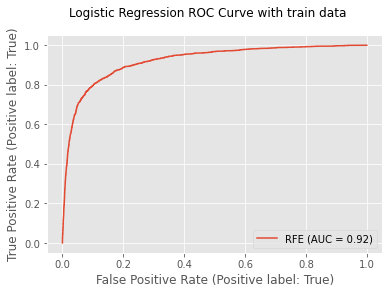

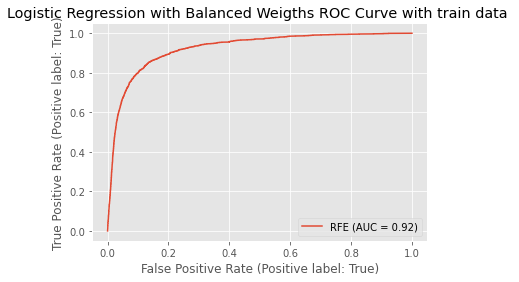

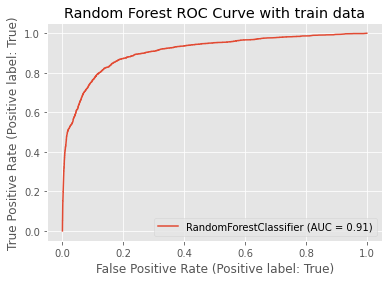

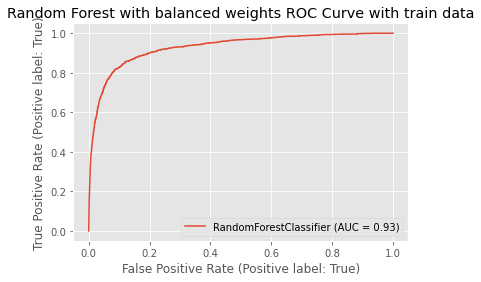

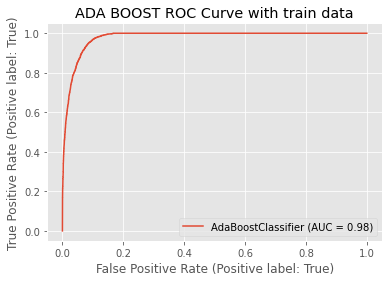

In [1039]:
from sklearn.metrics import plot_roc_curve

plot_roc_curve(logit, X_train, y_train, drop_intermediate=False)
plt.suptitle("Logistic Regression ROC Curve with train data ")

plot_roc_curve(logit_balanced, X_train, y_train, drop_intermediate=False)
plt.title("Logistic Regression with Balanced Weigths ROC Curve with train data ")

plot_roc_curve(rf_best, X_train, y_train, drop_intermediate=False)
plt.title("Random Forest ROC Curve with train data")

plot_roc_curve(rf_best_balanced, X_train, y_train, drop_intermediate=False)
plt.title("Random Forest with balanced weights ROC Curve with train data")


plot_roc_curve(ABC, X_train, y_train, drop_intermediate=False)
plt.title("ADA BOOST ROC Curve with train data")

plt.show()

###### Observation
The ADA boost model seems to be overfitting. 

#### Comparing the ROC AUC Curve for the models for test data

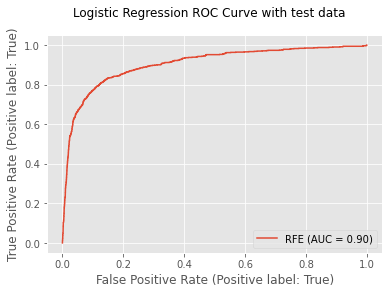

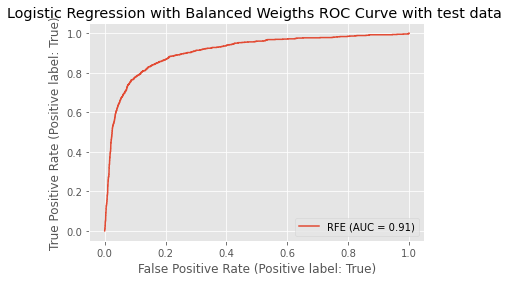

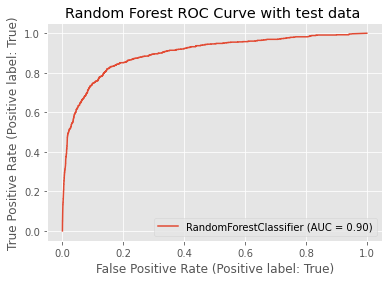

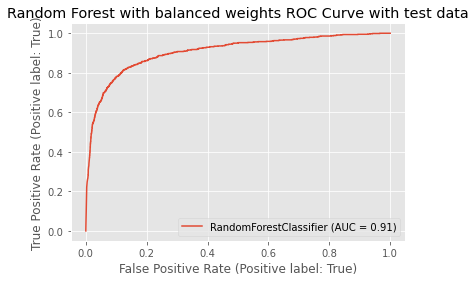

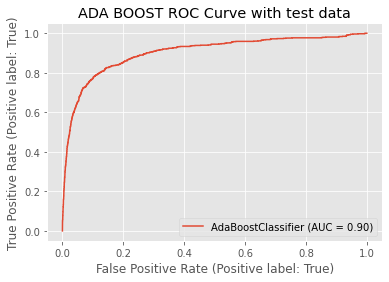

In [1040]:
from sklearn.metrics import plot_roc_curve

plot_roc_curve(logit, X_test, y_test, drop_intermediate=False)
plt.suptitle("Logistic Regression ROC Curve with test data")

plot_roc_curve(logit_balanced, X_test, y_test, drop_intermediate=False)
plt.title("Logistic Regression with Balanced Weigths ROC Curve with test data ")

plot_roc_curve(rf_best, X_test, y_test, drop_intermediate=False)
plt.title("Random Forest ROC Curve with test data ")

plot_roc_curve(rf_best_balanced, X_test, y_test, drop_intermediate=False)
plt.title("Random Forest with balanced weights ROC Curve with test data")


plot_roc_curve(ABC, X_test, y_test, drop_intermediate=False)
plt.title("ADA BOOST ROC Curve with test data")

plt.show()

#### Observation
All the models seem to be fitting the train data well and the performance is similar on the test data The Logistic Regression model with param balanced weights and random forest with balanced subsamples seem to have the highest AUC of .91

##### FEATURE IMPORTANCE

In [1041]:
# Looking at feature importance for logistic regression model 
#Sort the features selected by RFE 
importance = sorted(logit_balanced.ranking_)
#Select top 70
importance = importance[:70]
imp = pd.DataFrame({"Features":X.columns[logit_balanced.support_],
              "Importance":importance})

sorted_imp_features = imp.sort_values(by="Importance",ascending=False)
sorted_imp_features.head(10)



,Features,Importance
0,arpu_7,1
44,arpu_2g_8,1
50,ratio_local_to_total_6,1
49,jun_vbc_3g,1
48,aon,1
47,fb_user_8,1
46,sachet_2g_8,1
45,monthly_2g_8,1
43,arpu_3g_8,1
52,ratio_local_to_total_8,1


In [1042]:
importance = rf_best_balanced.feature_importances_

imp = pd.DataFrame({"Features":X.columns,
              "Importance":importance})

sorted_imp_features = imp.sort_values(by="Importance",ascending=False)
sorted_imp_features.head(10)

,Features,Importance
65,loc_ic_t2m_mou_8,0.091241
157,total_mou_8,0.087958
160,avg_rch_amt_8,0.086949
62,loc_ic_t2t_mou_8,0.085384
71,loc_ic_mou_8,0.071628
23,loc_og_t2m_mou_8,0.054328
86,std_ic_mou_8,0.046227
89,total_ic_mou_8,0.036526
14,roam_ic_mou_8,0.035805
59,total_og_mou_8,0.031862


###### Observation
The above cells display the features that are important according to  the models with imbalanced data.
The two models considered here are balanced Logistic Regression and Balanced Random Forest.

In the next step the same models will be built with balanced data. The feature importance will be discussed in the following cells. 

### Handling Imbalanced data with SMOTE

In [1043]:
# import SMOTE module from imblearn library
#conda install -c conda-forge imbalanced-learn
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state = 2)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train.ravel())
  
print('After OverSampling, the shape of X_train: {}'.format(X_train_res.shape))
print('After OverSampling, the shape of y_train: {} \n'.format(y_train_res.shape))
  
print("After OverSampling, count of churners '1': {}".format(sum(y_train_res == 1)))
print("After OverSampling, count of non-churners '0': {}".format(sum(y_train_res == 0)))

After OverSampling, the shape of X_train: (38384, 206)
After OverSampling, the shape of y_train: (38384,) 

After OverSampling, count of churners '1': 19192
After OverSampling, count of non-churners '0': 19192


### APPROACH 2:    Model after handling Data Imbalance

#### Logistic Regression

##### without balanced weigths

In [1044]:
#Fit a Logistic Regression Model
lm = LogisticRegression()

### RFE

In [1045]:
#70 Features are chosen
logit = RFE(lm, 70)
logit = logit.fit(X_train_res,y_train_res)

##### with balanced weigths

In [1046]:
# class_weight='balanced' is used since there is a class imbalance
lm_balanced = LogisticRegression(class_weight='balanced')
logit_balanced = RFE(lm_balanced, 70)
logit_balanced = logit_balanced.fit(X_train_res,y_train_res)

#### Random Forest

##### without balanced weigths

In [1047]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
rf = RandomForestClassifier(random_state=42, n_jobs=-1)
# params to tune the model to the best 
params = {
    'max_depth': [2,3,5,6,7],
#     'min_samples_leaf': [5,10,20,50],
    'n_estimators': [10, 25, 50, 100]
}
grid_search = GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 10,
                           n_jobs=-1, verbose=1, scoring="recall")

In [1048]:
%%time
grid_search.fit(X_train_res, y_train_res)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
Wall time: 7min 23s


GridSearchCV(cv=10,
             estimator=RandomForestClassifier(n_jobs=-1, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': [2, 3, 5, 6, 7],
                         'n_estimators': [10, 25, 50, 100]},
             scoring='recall', verbose=1)

In [1049]:
rf_best = grid_search.best_estimator_
rf_best

RandomForestClassifier(max_depth=7, n_jobs=-1, random_state=42)

##### with 'balanced_subsample' weigths

In [1050]:
# class_weight='balanced' is used since there is a class imbalance
rf_balanced = RandomForestClassifier(random_state=42, n_jobs=-1,class_weight='balanced_subsample')

grid_search_balanced = GridSearchCV(estimator=rf_balanced,
                           param_grid=params,
                           cv = 10,
                           n_jobs=-1, verbose=1, scoring="recall")
grid_search_balanced.fit(X_train_res, y_train_res)
rf_best_balanced = grid_search_balanced.best_estimator_
rf_best_balanced

Fitting 10 folds for each of 20 candidates, totalling 200 fits


RandomForestClassifier(class_weight='balanced_subsample', max_depth=7,
                       n_jobs=-1, random_state=42)

#### ADA BOOST

In [1051]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier
# base estimator: a weak learner with max_depth=2
shallow_tree = DecisionTreeClassifier(max_depth=2, random_state = 100)
# fit the shallow decision tree 
shallow_tree.fit(X_train_res, y_train_res)
ABC = AdaBoostClassifier(base_estimator=shallow_tree, n_estimators = 100, random_state=10)
ABC.fit(X_train_res, y_train_res)

AdaBoostClassifier(base_estimator=DecisionTreeClassifier(max_depth=2,
                                                         random_state=100),
                   n_estimators=100, random_state=10)

#### Comparing the Classification Report for the models with train data

In [1052]:
from sklearn.metrics import classification_report
print("*"*20,"LOGISTIC REGRESSION WITH TRAIN DATA","*"*20)
print(classification_report(y_train_res, logit.predict(X_train_res)))
print("*"*20,"LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TRAIN DATA","*"*20)
print(classification_report(y_train_res, logit_balanced.predict(X_train_res)))
print("*"*20,"RANDOM FOREST WITH TRAIN DATA","*"*20)
print(rf_best)
print(classification_report(y_train_res, rf_best.predict(X_train_res)))
print("*"*20,"RANDOM FOREST BALANCED WITH TRAIN DATA","*"*20)
print(rf_best_balanced)
print(classification_report(y_train_res, rf_best_balanced.predict(X_train_res)))
print("*"*20,"ADA BOOST WITH TRAIN DATA","*"*20)
print(classification_report(y_train_res, ABC.predict(X_train_res)))

******************** LOGISTIC REGRESSION WITH TRAIN DATA ********************
              precision    recall  f1-score   support

       False       0.87      0.88      0.87     19192
        True       0.88      0.87      0.87     19192

    accuracy                           0.87     38384
   macro avg       0.87      0.87      0.87     38384
weighted avg       0.87      0.87      0.87     38384

******************** LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TRAIN DATA ********************
              precision    recall  f1-score   support

       False       0.87      0.88      0.87     19192
        True       0.88      0.87      0.87     19192

    accuracy                           0.87     38384
   macro avg       0.87      0.87      0.87     38384
weighted avg       0.87      0.87      0.87     38384

******************** RANDOM FOREST WITH TRAIN DATA ********************
RandomForestClassifier(max_depth=7, n_jobs=-1, random_state=42)
              precision    recal

In [1053]:
#Tabulating the results

logit_results_c = classification_report(y_train, logit.predict(X_train),output_dict=True)
logit_results = { "Model":"Logistic Regression",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":logit_results_c["True"]["recall"],
                 "F1_score":logit_results_c["True"]["f1-score"]}
results = results.append(logit_results,ignore_index=True)
logit_results_c2 = classification_report(y_train, logit_balanced.predict(X_train),output_dict=True)
logit_results2 = { "Model":"Logistic Regression",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced_weights",
                 "Recall Score":logit_results_c2["True"]["recall"],
                 "F1_score":logit_results_c2["True"]["f1-score"]}
results = results.append(logit_results2,ignore_index=True)
rf_results_c1 = classification_report(y_train, rf_best.predict(X_train),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yse",
                 "Model_params":"None",
                 "Recall Score":rf_results_c1["True"]["recall"],
                 "F1_score":rf_results_c1["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
rf_results_c2 = classification_report(y_train, rf_best_balanced.predict(X_train),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced weights",
                 "Recall Score":rf_results_c2["True"]["recall"],
                 "F1_score":rf_results_c2["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
abc_results = classification_report(y_train, ABC.predict(X_train), output_dict=True)
abc_results = { "Model":"ADA BOOST",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":abc_results["True"]["recall"],
                 "F1_score":abc_results["True"]["f1-score"]}
results = results.append(abc_results,ignore_index=True)
results

,Model,Train/Test,Data_Balanced,Model_params,Recall Score,F1_score
0,Logistic Regression,Train,No,None,0.504683,0.581957
1,Logistic Regression,Train,No,Balanced_weights,0.843526,0.526207
2,Random Forest,Train,No,None,0.488705,0.592518
3,Random Forest,Train,No,Balanced weights,0.801102,0.608878
4,ADA BOOST,Train,No,None,0.638567,0.696933
5,Logistic Regression,Test,No,None,0.512853,0.586765
6,Logistic Regression,Test,No,Balanced_weights,0.811054,0.504195
7,Random Forest,Test,No,None,0.745501,0.570585
8,Random Forest,Test,No,Balanced weights,0.745501,0.570585
9,ADA BOOST,Test,No,None,0.520566,0.581897


#### Comparing the Classification Report for the models with test data

In [1054]:
from sklearn.metrics import classification_report
print("*"*20,"LOGISTIC REGRESSION WITH TEST DATA","*"*20)
print(classification_report(y_test, logit.predict(X_test)))
print("*"*20,"LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TEST DATA","*"*20)
print(classification_report(y_test, logit_balanced.predict(X_test)))
print("*"*20,"RANDOM FOREST WITH TEST DATA","*"*20)
print(rf_best)
print(classification_report(y_test, rf_best.predict(X_test)))
print("*"*20,"RANDOM FOREST BALANCED WITH TEST DATA","*"*20)
print(rf_best_balanced)
print(classification_report(y_test, rf_best_balanced.predict(X_test)))
print("*"*20,"ADA BOOST WITH TEST DATA","*"*20)
print(classification_report(y_test, ABC.predict(X_test)))

******************** LOGISTIC REGRESSION WITH TEST DATA ********************
              precision    recall  f1-score   support

       False       0.98      0.88      0.93      8226
        True       0.39      0.81      0.52       778

    accuracy                           0.87      9004
   macro avg       0.68      0.84      0.72      9004
weighted avg       0.93      0.87      0.89      9004

******************** LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TEST DATA ********************
              precision    recall  f1-score   support

       False       0.98      0.88      0.93      8226
        True       0.39      0.81      0.52       778

    accuracy                           0.87      9004
   macro avg       0.68      0.84      0.72      9004
weighted avg       0.93      0.87      0.89      9004

******************** RANDOM FOREST WITH TEST DATA ********************
RandomForestClassifier(max_depth=7, n_jobs=-1, random_state=42)
              precision    recall  

#### Comparing the ROC AUC Curve for the models with Train Data

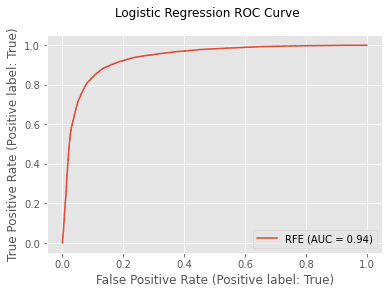

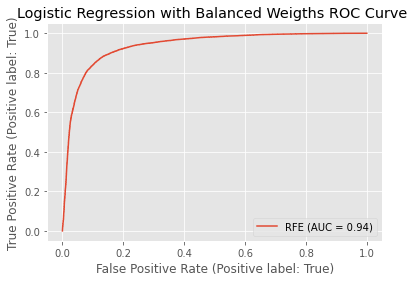

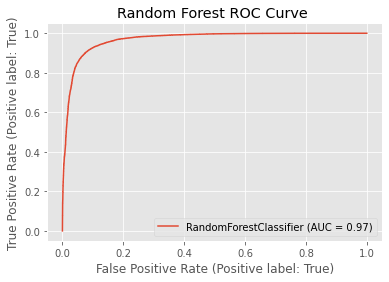

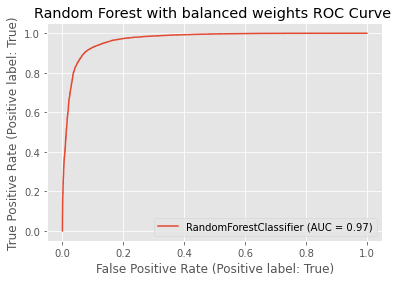

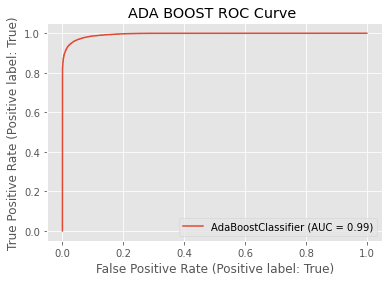

In [1055]:
from sklearn.metrics import plot_roc_curve

plot_roc_curve(logit, X_train_res, y_train_res, drop_intermediate=False)
plt.suptitle("Logistic Regression ROC Curve ")

plot_roc_curve(logit_balanced, X_train_res, y_train_res, drop_intermediate=False)
plt.title("Logistic Regression with Balanced Weigths ROC Curve ")

plot_roc_curve(rf_best, X_train_res, y_train_res, drop_intermediate=False)
plt.title("Random Forest ROC Curve ")

plot_roc_curve(rf_best_balanced, X_train_res, y_train_res, drop_intermediate=False)
plt.title("Random Forest with balanced weights ROC Curve ")


plot_roc_curve(ABC, X_train_res, y_train_res, drop_intermediate=False)
plt.title("ADA BOOST ROC Curve ")

plt.show()

#### Comparing the ROC AUC Curve for the models

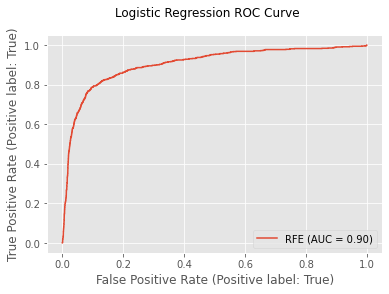

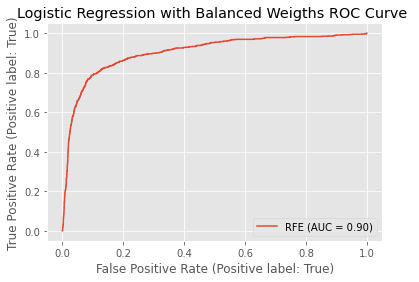

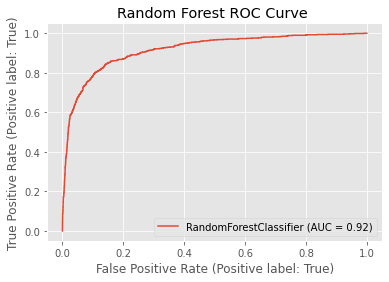

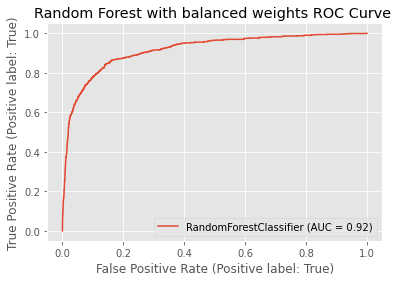

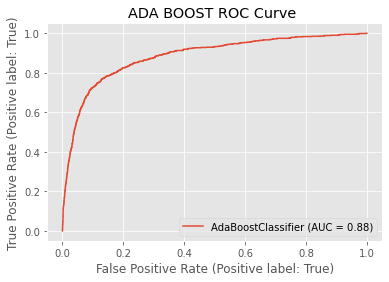

In [1056]:
from sklearn.metrics import plot_roc_curve

plot_roc_curve(logit, X_test, y_test, drop_intermediate=False)
plt.suptitle("Logistic Regression ROC Curve ")

plot_roc_curve(logit_balanced, X_test, y_test, drop_intermediate=False)
plt.title("Logistic Regression with Balanced Weigths ROC Curve ")

plot_roc_curve(rf_best, X_test, y_test, drop_intermediate=False)
plt.title("Random Forest ROC Curve ")

plot_roc_curve(rf_best_balanced, X_test, y_test, drop_intermediate=False)
plt.title("Random Forest with balanced weights ROC Curve ")


plot_roc_curve(ABC, X_test, y_test, drop_intermediate=False)
plt.title("ADA BOOST ROC Curve ")

plt.show()

### Tabulating Results of Models used for Interpreting Feature Importance

In [1057]:
# Tabulating the results
logit_results_c = classification_report(y_test, logit.predict(X_test),output_dict=True)
logit_results = { "Model":"Logistic Regression",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":logit_results_c["True"]["recall"],
                 "F1_score":logit_results_c["True"]["f1-score"]}
results = results.append(logit_results,ignore_index=True)
logit_results_c2 = classification_report(y_test, logit_balanced.predict(X_test),output_dict=True)
logit_results2 = { "Model":"Logistic Regression",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced_weights",
                 "Recall Score":logit_results_c2["True"]["recall"],
                 "F1_score":logit_results_c2["True"]["f1-score"]}
results = results.append(logit_results2,ignore_index=True)
rf_results_c1 = classification_report(y_test, rf_best_balanced.predict(X_test),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":rf_results_c1["True"]["recall"],
                 "F1_score":rf_results_c1["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
rf_results_c2 = classification_report(y_test, rf_best_balanced.predict(X_test),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced weights",
                 "Recall Score":rf_results_c2["True"]["recall"],
                 "F1_score":rf_results_c2["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
abc_results = classification_report(y_test, ABC.predict(X_test), output_dict=True)
abc_results = { "Model":"ADA BOOST",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":" None",
                 "Recall Score":abc_results["True"]["recall"],
                 "F1_score":abc_results["True"]["f1-score"]}
results = results.append(abc_results,ignore_index=True)
results

,Model,Train/Test,Data_Balanced,Model_params,Recall Score,F1_score
0,Logistic Regression,Train,No,None,0.504683,0.581957
1,Logistic Regression,Train,No,Balanced_weights,0.843526,0.526207
2,Random Forest,Train,No,None,0.488705,0.592518
3,Random Forest,Train,No,Balanced weights,0.801102,0.608878
4,ADA BOOST,Train,No,None,0.638567,0.696933
5,Logistic Regression,Test,No,None,0.512853,0.586765
6,Logistic Regression,Test,No,Balanced_weights,0.811054,0.504195
7,Random Forest,Test,No,None,0.745501,0.570585
8,Random Forest,Test,No,Balanced weights,0.745501,0.570585
9,ADA BOOST,Test,No,None,0.520566,0.581897


##### ANALYSIS OF RESULTS
The best performing models are
1. Logistic Regression model with  parameter for balancing weights on unbalanced data and has a score of 0.84 for recall and 0.53 for F1 score on the test data.
2.  Logistic Regression model with balanced(oversampled) data has a score of 0.81 for recall and 0.51 for F1 score on the test data.
3. Random forest  on unbalanced data with parameter set to balance weigths has a score of 0.79 for recall and 0.57 for F1 score on the test data.

##### FEATURE IMPORTANCE

In [1058]:
# Looking at feature importance for logistic regression model with balanced weights of unbalanced data
#Sort the features selected by RFE 
importance = sorted(logit_balanced.ranking_)
#Select top 70 
importance = importance[:70]
imp = pd.DataFrame({"Features":X.columns[logit_balanced.support_],
              "Importance":importance})

sorted_imp_features = imp.sort_values(by="Importance")
sorted_imp_features.head(10)

,Features,Importance
0,arpu_7,1
37,total_rech_num_7,1
38,total_rech_num_8,1
39,total_rech_amt_6,1
40,total_rech_amt_8,1
41,max_rech_amt_8,1
42,last_day_rch_amt_8,1
43,vol_2g_mb_8,1
44,vol_3g_mb_8,1
45,arpu_3g_8,1


In [1059]:
# Looking at feature importance for Random Forest  model with balanced weights of unbalanced data
importance = rf_best_balanced.feature_importances_

imp = pd.DataFrame({"Features":X.columns,
              "Importance":importance})

sorted_imp_features = imp.sort_values(by="Importance",ascending=False)
sorted_imp_features.head(10)

,Features,Importance
157,total_mou_8,0.074057
65,loc_ic_t2m_mou_8,0.072103
89,total_ic_mou_8,0.064851
71,loc_ic_mou_8,0.055909
154,ratio_roam_to_total_8,0.049273
104,total_rech_amt_8,0.044606
17,roam_og_mou_8,0.038910
32,loc_og_mou_8,0.038180
23,loc_og_t2m_mou_8,0.036274
14,roam_ic_mou_8,0.034636


### Suggestion to the Telecom Company
   
   1. The August month is when patterns of the Churners are very evident slight behavioural patterns are visible during July too
   2. The major patterns seen by Churner behaviour are:
        a. Drop in average revenue per user in the month of August.
        b. Drop in Local incoming calls.
        c. Increase in roam outgoing calls.
        d. Average recharge amount and revenue in the month of August decreases.
        f. Decrease in onnet minutes of usage.
        
        
        
 To avoid Churners these following suggestion can be considered

1. As we have seen an increase in roaming outgoing calls, companies need to pay more attention to roaming rates. They can provide any good offers or discounts to the customers.
 
2. Since there is a decrease in recharge amount for Churners, a reduce in recharge amount will help them to not Churn.

3. Since local calls both incoming and outgoing have reduced for Churners attractive packages for local calls will help them. 

###  PCA

In [1060]:
#Since there are may columns that have multicollinearity use of PCA will reduce the multicollinearity without loosing information
from sklearn.decomposition import PCA
#initialise PCA
pca = PCA(random_state=42)
pca.fit(X_train_res)


PCA(random_state=42)

##### Components from PCA

In [1061]:
pca.components_

array([[-7.77895392e-20,  9.71445147e-17, -5.55111512e-17, ...,
        -0.00000000e+00, -0.00000000e+00,  9.90665591e-02],
       [ 2.29438488e-19,  0.00000000e+00,  0.00000000e+00, ...,
         0.00000000e+00,  0.00000000e+00, -4.40778430e-02],
       [ 1.02755888e-18,  1.66533454e-16,  5.55111512e-16, ...,
        -0.00000000e+00, -0.00000000e+00,  1.32244861e-01],
       ...,
       [ 9.99976167e-01,  6.14345885e-03, -3.10765808e-03, ...,
        -0.00000000e+00, -0.00000000e+00,  2.17279814e-04],
       [-0.00000000e+00, -4.18425192e-01, -8.34254462e-01, ...,
        -0.00000000e+00, -0.00000000e+00,  3.90649855e-03],
       [-0.00000000e+00, -2.26176697e-02, -1.92742079e-04, ...,
        -0.00000000e+00, -0.00000000e+00,  2.89168890e-01]])

##### Making a Scree Plot to explain variance ratio

Text(0, 0.5, 'Cumulative variance')

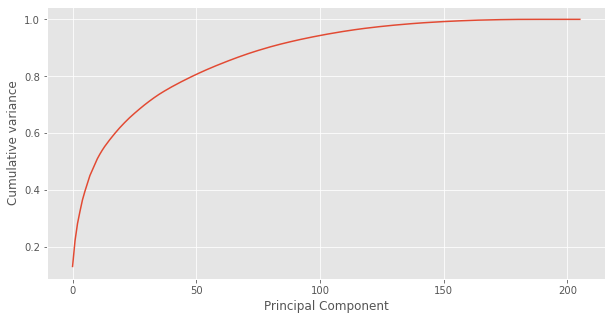

In [1062]:
#Scree plot to show total variance explained 
fig=plt.figure(figsize=[10,5])
var_cum=np.cumsum(pca.explained_variance_ratio_)
plt.plot(var_cum)
plt.xlabel('Principal Component')
plt.ylabel('Cumulative variance')

Choosing 95% explained_varience ratio

In [1063]:
# Perform PCA with 60 components
from sklearn.decomposition import IncrementalPCA
# pca_final=IncrementalPCA(n_components=60)
pca_final = PCA(.95)

In [1064]:
X_train_pca=pca_final.fit_transform(X_train_res)

In [1065]:
X_train_pca.shape

(38384, 106)

In [1066]:
corrmat = np.corrcoef(X_train_pca.transpose())
corrmat.shape

(106, 106)

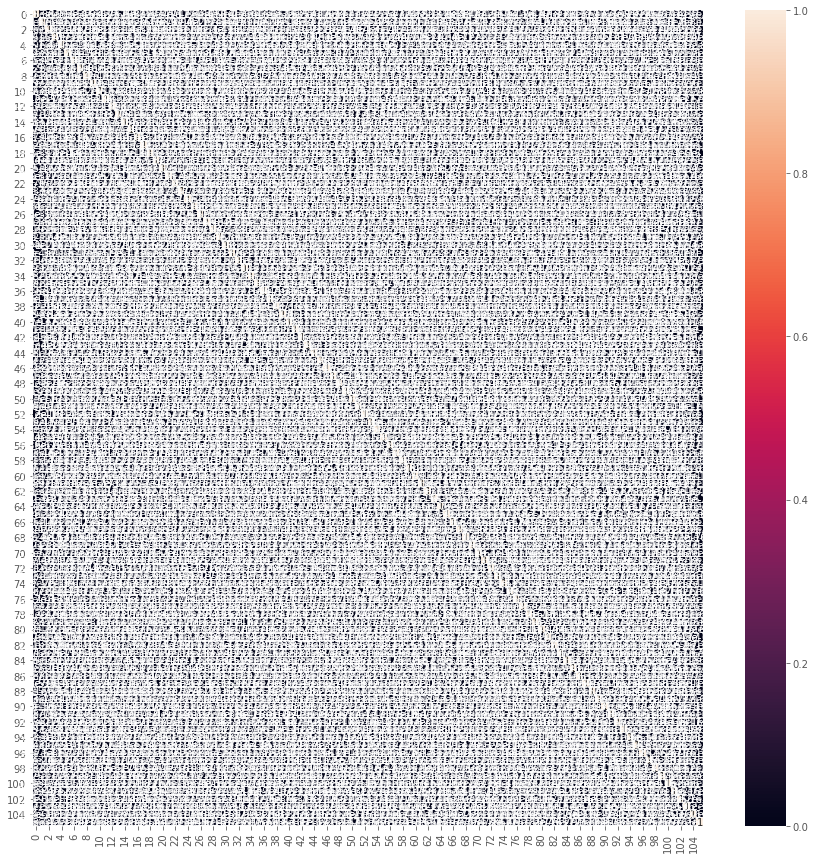

In [1067]:
plt.figure(figsize=[15,15])
sns.heatmap(corrmat,annot=True)

###### Observation
PCA has removed all multicollinearity present in the data.

In [1068]:
#Applying the transformation on test
X_test_pca = pca_final.transform(X_test)
X_test_pca.shape

(9004, 106)

###  APPROACH 3:    Model after handling Data Imbalance Models with high performance

#### Logistic Regression

#### without balanced weigths

In [1069]:
#Fit a Logistic Regression Model
logit = LogisticRegression(C=0.1)
logit.fit(X_train_pca,y_train_res)

LogisticRegression(C=0.1)

#### with balanced weigths

In [1070]:
# class_weight='balanced' is used since there is a class imbalance
logit_balanced = LogisticRegression(class_weight='balanced',C=0.1)
logit_balanced.fit(X_train_pca,y_train_res)

LogisticRegression(C=0.1, class_weight='balanced')

#### Random Forest

#### without balanced weigths

In [1071]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
rf = RandomForestClassifier(random_state=42, n_jobs=-1)
#Checking for hyperparams to tune the model using grid search
params = {
    'max_depth': [2,3,5,6,7],
#     'min_samples_leaf': [5,10,20,50],
    'n_estimators': [10, 25, 50, 100]
}
grid_search = GridSearchCV(estimator=rf,
                           param_grid=params,
                           cv = 10,
                           n_jobs=-1, verbose=1, scoring="recall")

In [1072]:
#Fitting the model
%%time
grid_search.fit(X_train_pca, y_train_res)

UsageError: Line magic function `%%time` not found.


In [ ]:
#Displaying the best model
rf_best = grid_search.best_estimator_
rf_best

#### with 'balanced_subsample' weigths

In [ ]:
# class_weight='balanced' is used since there is a class imbalance
rf_balanced = RandomForestClassifier(random_state=42, n_jobs=-1,class_weight='balanced_subsample')

grid_search_balanced = GridSearchCV(estimator=rf_balanced,
                           param_grid=params,
                           cv = 10,
                           n_jobs=-1, verbose=1, scoring="recall")
grid_search_balanced.fit(X_train_pca, y_train_res)
rf_best_balanced = grid_search_balanced.best_estimator_
rf_best_balanced

#### ADA BOOST

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier
# base estimator: a weak learner with max_depth=2
shallow_tree = DecisionTreeClassifier(max_depth=2, random_state = 100)
# fit the shallow decision tree 
shallow_tree.fit(X_train_pca, y_train_res)
ABC = AdaBoostClassifier(base_estimator=shallow_tree, n_estimators = 100, random_state=10)
ABC.fit(X_train_pca, y_train_res)

#### Comparing the Classification Report for the models with train data

In [ ]:
from sklearn.metrics import classification_report
print("*"*20,"LOGISTIC REGRESSION WITH TRAIN DATA","*"*20)
print(classification_report(y_train_res, logit.predict(X_train_pca)))
print("*"*20,"LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TRAIN DATA","*"*20)
print(classification_report(y_train_res, logit_balanced.predict(X_train_pca)))
print("*"*20,"RANDOM FOREST WITH TRAIN DATA","*"*20)
print(rf_best)
print(classification_report(y_train_res, rf_best.predict(X_train_pca)))
print("*"*20,"RANDOM FOREST BALANCED WITH TRAIN DATA","*"*20)
print(rf_best_balanced)
print(classification_report(y_train_res, rf_best_balanced.predict(X_train_pca)))
print("*"*20,"ADA BOOST WITH TRAIN DATA","*"*20)
print(classification_report(y_train_res, ABC.predict(X_train_pca)))

In [ ]:
#Tabulating the results
results = pd.DataFrame({"Model":[],
                        "Train/Test":[],
              "Data_Balanced":[],
              "Model_params":[],
              "Recall Score":[],
              "F1_score":[]})
logit_results_c = classification_report(y_train_res, logit.predict(X_train_pca),output_dict=True)
logit_results = { "Model":"Logistic Regression",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":logit_results_c["True"]["recall"],
                 "F1_score":logit_results_c["True"]["f1-score"]}
results = results.append(logit_results,ignore_index=True)
logit_results_c2 = classification_report(y_train_res, logit_balanced.predict(X_train_pca),output_dict=True)
logit_results2 = { "Model":"Logistic Regression",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced_weights",
                 "Recall Score":logit_results_c2["True"]["recall"],
                 "F1_score":logit_results_c2["True"]["f1-score"]}
results = results.append(logit_results2,ignore_index=True)
rf_results_c1 = classification_report(y_train_res, rf_best.predict(X_train_pca),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yse",
                 "Model_params":"None",
                 "Recall Score":rf_results_c1["True"]["recall"],
                 "F1_score":rf_results_c1["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
rf_results_c2 = classification_report(y_train_res, rf_best_balanced.predict(X_train_pca),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced weights",
                 "Recall Score":rf_results_c2["True"]["recall"],
                 "F1_score":rf_results_c2["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
abc_results = classification_report(y_train_res, ABC.predict(X_train_pca), output_dict=True)
abc_results = { "Model":"ADA BOOST",
                 "Train/Test":"Train",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":abc_results["True"]["recall"],
                 "F1_score":abc_results["True"]["f1-score"]}
results = results.append(abc_results,ignore_index=True)
results

#### Comparing the Classification Report for the models with test data

In [ ]:
from sklearn.metrics import classification_report
print("*"*20,"LOGISTIC REGRESSION WITH TEST DATA","*"*20)
print(classification_report(y_test, logit.predict(X_test_pca)))
print("*"*20,"LOGISTIC REGRESSION WITH BALANCED WEIGHTS WITH TEST DATA","*"*20)
print(classification_report(y_test, logit_balanced.predict(X_test_pca)))
print("*"*20,"RANDOM FOREST WITH TEST DATA","*"*20)
print(rf_best)
print(classification_report(y_test, rf_best.predict(X_test_pca)))
print("*"*20,"RANDOM FOREST BALANCED WITH TEST DATA","*"*20)
print(rf_best_balanced)
print(classification_report(y_test, rf_best_balanced.predict(X_test_pca)))
print("*"*20,"ADA BOOST WITH TEST DATA ","*"*20)
print(classification_report(y_test, ABC.predict(X_test_pca)))

#### Comparing the ROC AUC Curve for the models with Train Data

In [ ]:
from sklearn.metrics import plot_roc_curve

plot_roc_curve(logit, X_train_pca, y_train_res, drop_intermediate=False)
plt.suptitle("Logistic Regression ROC Curve with Train Data")

plot_roc_curve(logit_balanced, X_train_pca, y_train_res, drop_intermediate=False)
plt.title("Logistic Regression with Balanced Weigths ROC Curve with Train Data")

plot_roc_curve(rf_best, X_train_pca, y_train_res, drop_intermediate=False)
plt.title("Random Forest ROC Curve with Train Data")

plot_roc_curve(rf_best_balanced, X_train_pca, y_train_res, drop_intermediate=False)
plt.title("Random Forest with balanced weights ROC Curve with Train Data ")


plot_roc_curve(ABC, X_train_pca, y_train_res, drop_intermediate=False)
plt.title("ADA BOOST ROC Curve with Train Data ")

plt.show()

###### Observation
The best performing models are random forest . ADA boost seems to be overfitting the data. Conclusions can be drawn after checking test data

#### Comparing the ROC AUC Curve for the models with test data

In [ ]:
from sklearn.metrics import plot_roc_curve

plot_roc_curve(logit, X_test_pca, y_test, drop_intermediate=False)
plt.suptitle("Logistic Regression ROC Curve With Test Data")

plot_roc_curve(logit_balanced, X_test_pca, y_test, drop_intermediate=False)
plt.title("Logistic Regression with Balanced Weigths ROC Curve With Test Data ")

plot_roc_curve(rf_best, X_test_pca, y_test, drop_intermediate=False)
plt.title("Random Forest ROC Curve With Test Data")

plot_roc_curve(rf_best_balanced, X_test_pca, y_test, drop_intermediate=False)
plt.title("Random Forest with balanced weights ROC Curve With Test Data")


plot_roc_curve(ABC, X_test_pca, y_test, drop_intermediate=False)
plt.title("ADA BOOST ROC Curve With Test Data")

plt.show()

### Tabulating The Results

In [ ]:
# Tabulating the results
logit_results_c = classification_report(y_test, logit.predict(X_test_pca),output_dict=True)
logit_results = { "Model":"Logistic Regression",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":logit_results_c["True"]["recall"],
                 "F1_score":logit_results_c["True"]["f1-score"]}
results = results.append(logit_results,ignore_index=True)
logit_results_c2 = classification_report(y_test, logit_balanced.predict(X_test_pca),output_dict=True)
logit_results2 = { "Model":"Logistic Regression",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced_weights",
                 "Recall Score":logit_results_c2["True"]["recall"],
                 "F1_score":logit_results_c2["True"]["f1-score"]}
results = results.append(logit_results2,ignore_index=True)
rf_results_c1 = classification_report(y_test, rf_best.predict(X_test_pca),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yse",
                 "Model_params":"None",
                 "Recall Score":rf_results_c1["True"]["recall"],
                 "F1_score":rf_results_c1["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
rf_results_c2 = classification_report(y_test, rf_best_balanced.predict(X_test_pca),output_dict=True)
rf_results = { "Model":"Random Forest",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"Balanced weights",
                 "Recall Score":rf_results_c2["True"]["recall"],
                 "F1_score":rf_results_c2["True"]["f1-score"]}
results = results.append(rf_results,ignore_index=True)
abc_results = classification_report(y_test, ABC.predict(X_test_pca), output_dict=True)
abc_results = { "Model":"ADA BOOST",
                 "Train/Test":"Test",
                 "Data_Balanced":"Yes",
                 "Model_params":"None",
                 "Recall Score":abc_results["True"]["recall"],
                 "F1_score":abc_results["True"]["f1-score"]}
results = results.append(abc_results,ignore_index=True)
results

### Interpreting The results

The best performing models for high performance after PCA was applied on data which was oversampled to balance data are 
1. Logistic Regression with recall rate of 0.81 and F1 score of 0.50 on test data.
2. Random forest data with recall rate of 0.76 and f1 score of .52 on test data.
3. Random Forest with the parameter "balanced_subsample" with recall rate of 0.76 and f1 score of .52 on test data.